In [20]:
import numpy as np
np.random.seed(42)
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
from sklearn.ensemble import IsolationForest
from sklearn import model_selection
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.feature_extraction import DictVectorizer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import learning_curve
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import validation_curve
from sklearn.model_selection import KFold, StratifiedShuffleSplit
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import SparsePCA, PCA
import rrcf

# Import all models
from pyod.models.abod import ABOD
from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.mcd import MCD
from pyod.models.ocsvm import OCSVM
from pyod.models.lscp import LSCP

from subprocess import check_output
import psutil
import platform
import os
import pandas as pd
import time
from imblearn.over_sampling import SMOTE
import scipy
from scipy import stats
import sys
import glob
import tqdm
%matplotlib inline
print("Checking files in data location ...")
print(check_output(["ls", "../new_data"]).decode("utf8"))
path_parent = os.path.dirname(os.getcwd())
data_dir = os.path.join(path_parent,'new_data')

Checking files in data location ...
20-09-eth-0.csv
20-09-eth-10.csv
20-09-eth-11.csv
20-09-eth-15.csv
20-09-eth-2.csv
20-09-eth-20.csv
20-09-eth-21.csv
20-09-eth-24.csv
20-09-eth-30.csv
20-09-eth-32.csv
20-09-eth-33.csv
20-09-eth-35.csv
20-09-eth-36.csv
20-09-eth-38.csv
20-09-eth-39.csv
20-09-eth-4.csv
20-09-eth-41.csv
20-09-eth-43.csv
20-09-eth-44.csv
20-09-eth-45.csv
20-09-eth-46.csv
20-09-eth-47.csv
20-09-eth-5.csv
20-09-eth-50.csv
20-09-eth-51.csv
20-09-eth-53.csv
20-09-eth-59.csv
20-09-eth-6.csv
20-09-eth-60.csv
20-09-eth-62.csv
20-09-eth-63.csv
20-09-eth-66.csv
20-09-eth-67.csv
20-09-eth-7.csv
20-09-eth-8.csv
20-09-eth-9.csv
20-09-ifaces-0.csv
20-09-ifaces-1.csv
20-09-ifaces-10.csv
20-09-ifaces-11.csv
20-09-ifaces-12.csv
20-09-ifaces-13.csv
20-09-ifaces-14.csv
20-09-ifaces-15.csv
20-09-ifaces-16.csv
20-09-ifaces-17.csv
20-09-ifaces-18.csv
20-09-ifaces-19.csv
20-09-ifaces-2.csv
20-09-ifaces-20.csv
20-09-ifaces-21.csv
20-09-ifaces-22.csv
20-09-ifaces-23.csv
20-09-ifaces-24.csv
20-

In [21]:
reg_file = "*-state-*.csv"
files = glob.glob(os.path.join(data_dir, reg_file))
list_df = []
for f in tqdm.tqdm(files):
    # print(f)
    df = pd.read_csv(f)
    list_df.append(df)

100%|██████████| 68/68 [00:02<00:00, 27.62it/s]


In [22]:
column_size = []
for d in list_df:
    print(d.shape)
    column_size.append(d.shape[-1])

(8480, 36)
(8505, 36)
(8503, 36)
(8506, 36)
(8505, 36)
(8356, 36)
(696, 36)
(8482, 36)
(8502, 36)
(8120, 36)
(8512, 36)
(7372, 36)
(8083, 36)
(8509, 36)
(8495, 36)
(8102, 36)
(8506, 36)
(8452, 36)
(8443, 36)
(8394, 36)
(8495, 36)
(8475, 36)
(8500, 36)
(8504, 36)
(8499, 36)
(8498, 36)
(8504, 36)
(8368, 36)
(8497, 36)
(8505, 36)
(8504, 36)
(8503, 36)
(8463, 36)
(8490, 36)
(8498, 36)
(8439, 36)
(2625, 36)
(8079, 36)
(8452, 36)
(8503, 36)
(8465, 36)
(8505, 36)
(8509, 36)
(8488, 36)
(8508, 36)
(8414, 36)
(8297, 36)
(8505, 36)
(8486, 36)
(8486, 36)
(8083, 36)
(8467, 36)
(8502, 36)
(8502, 36)
(8328, 36)
(8504, 36)
(8491, 36)
(8504, 36)
(8505, 36)
(8494, 36)
(8466, 36)
(6125, 36)
(8509, 36)
(8474, 36)
(8374, 36)
(8511, 36)
(8485, 36)
(8504, 36)


In [23]:
from collections import Counter
items = Counter(column_size).keys()
print("Unique column size: {}".format(items))

Unique column size: dict_keys([36])


In [24]:
df_work = list_df[0]
df_work.columns

Index(['date', 'uid', 'name', 'id', 'processes', 'loadavg.m1', 'softirq.rate',
       'iowait.rate', 'intr.rate', 'system.rate', 'btime.rate', 'idle.rate',
       'user.rate', 'irq.rate', 'ctxt.rate', 'nice.rate',
       'nr_slab_unreclaimable', 'workingset_refault', 'nr_anon_pages',
       'active_file', 'cached', 'apps', 'mapped', 'active_anon', 'free',
       'swap_cache', 'page_tables', 'inactive', 'shmem', 'committed', 'active',
       'vmalloc_used', 'slab_cache', 'buffers', 'swap', 'epoch'],
      dtype='object')

In [25]:
print("Checking low variance columns ...")
print("Starting Clean dataset")
uniques = df_work.apply(lambda x: x.nunique())
rm_columns = []
for uindex, uvalue in uniques.iteritems():
    if uvalue == 1:
        rm_columns.append(uindex)
print(rm_columns)

Checking low variance columns ...
Starting Clean dataset
['uid', 'name', 'iowait.rate', 'btime.rate', 'irq.rate', 'nice.rate', 'workingset_refault', 'swap_cache', 'vmalloc_used', 'swap']


In [26]:
# Find common low variance elements in list of low variance columns
list_low_varaince = []
for df in list_df:
# Check for monotonous columns and remove them
    print("Checking low variance columns ...")
    print("Starting Clean dataset")
    uniques = df.apply(lambda x: x.nunique())
    rm_columns = []
    for uindex, uvalue in uniques.iteritems():
        if uvalue == 1:
            rm_columns.append(uindex)
    print(rm_columns)
    list_low_varaince.append(rm_columns)

Checking low variance columns ...
Starting Clean dataset
['uid', 'name', 'iowait.rate', 'btime.rate', 'irq.rate', 'nice.rate', 'workingset_refault', 'swap_cache', 'vmalloc_used', 'swap']
Checking low variance columns ...
Starting Clean dataset
['uid', 'name', 'btime.rate', 'irq.rate', 'nice.rate', 'workingset_refault', 'swap_cache', 'vmalloc_used', 'swap']
Checking low variance columns ...
Starting Clean dataset
['uid', 'name', 'iowait.rate', 'btime.rate', 'irq.rate', 'nice.rate', 'workingset_refault', 'swap_cache', 'vmalloc_used', 'buffers', 'swap']
Checking low variance columns ...
Starting Clean dataset
['uid', 'name', 'iowait.rate', 'btime.rate', 'irq.rate', 'nice.rate', 'swap_cache', 'vmalloc_used', 'swap']
Checking low variance columns ...
Starting Clean dataset
['uid', 'name', 'iowait.rate', 'btime.rate', 'irq.rate', 'nice.rate', 'workingset_refault', 'active_file', 'swap_cache', 'vmalloc_used', 'buffers', 'swap']
Checking low variance columns ...
Starting Clean dataset
['uid', 

In [27]:
common_low_variance = list(set.intersection(*map(set, list_low_varaince)))
print(common_low_variance)

['irq.rate', 'nice.rate', 'swap_cache', 'name', 'uid', 'swap']


In [28]:
# Remove common low variance columns
for df in list_df:
    df.drop(common_low_variance, inplace=True, axis=1)

In [29]:
# Check datatypes of columns
for df in list_df:
    print(df.dtypes)


date                      object
id                         int64
processes                  int64
loadavg.m1               float64
softirq.rate             float64
iowait.rate                int64
intr.rate                float64
system.rate              float64
btime.rate                 int64
idle.rate                float64
user.rate                float64
ctxt.rate                float64
nr_slab_unreclaimable      int64
workingset_refault         int64
nr_anon_pages              int64
active_file                int64
cached                     int64
apps                       int64
mapped                     int64
active_anon                int64
free                       int64
page_tables                int64
inactive                   int64
shmem                      int64
committed                  int64
active                     int64
vmalloc_used               int64
slab_cache                 int64
buffers                    int64
epoch                      int64
dtype: obj

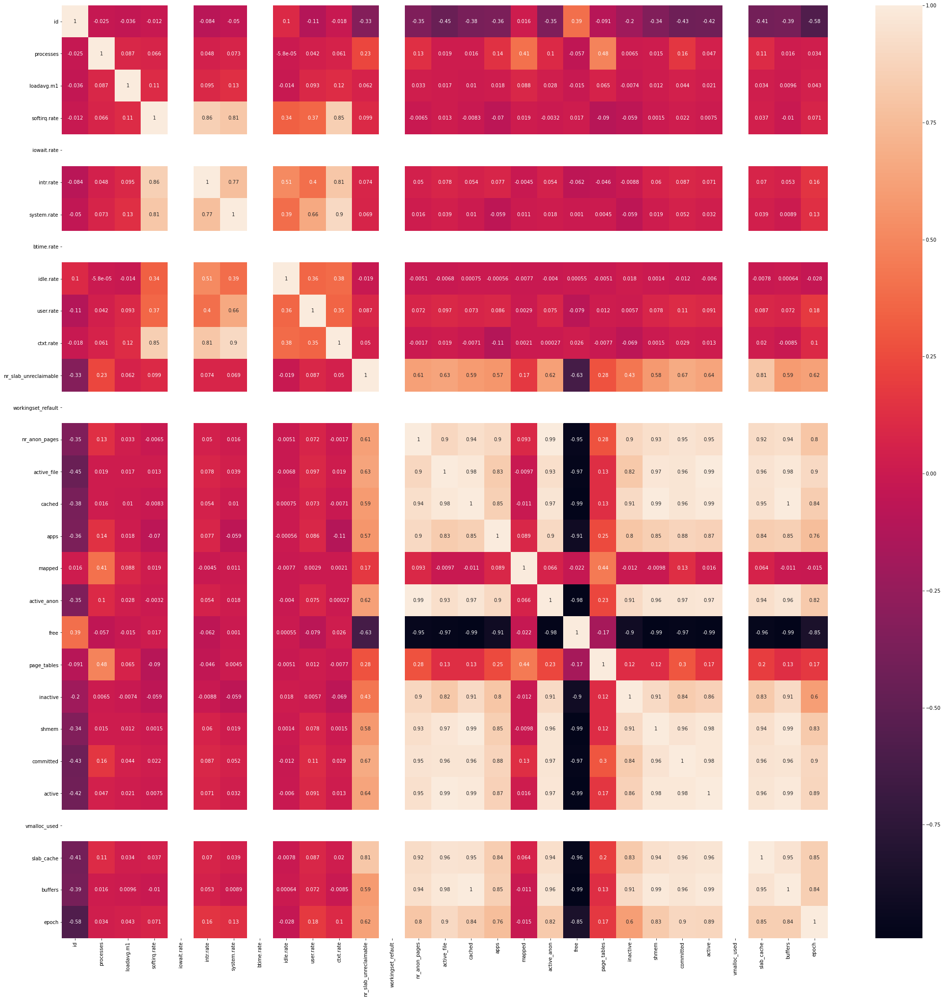

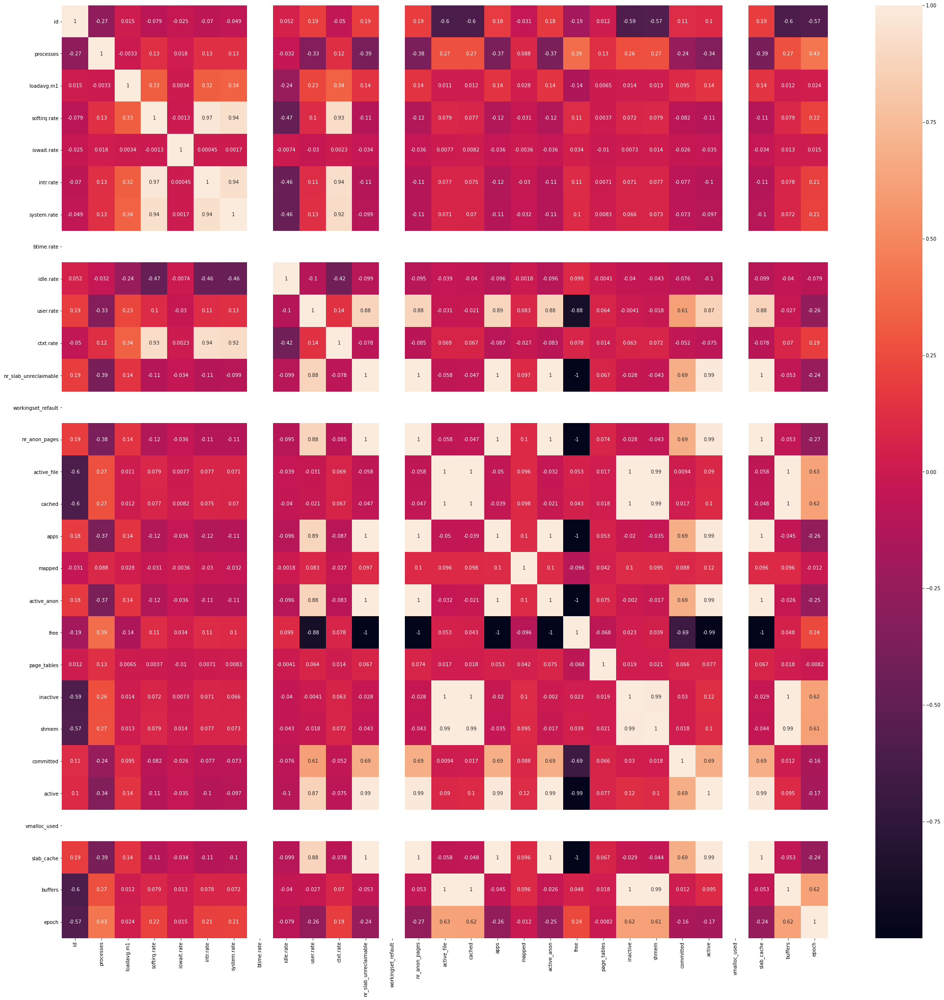

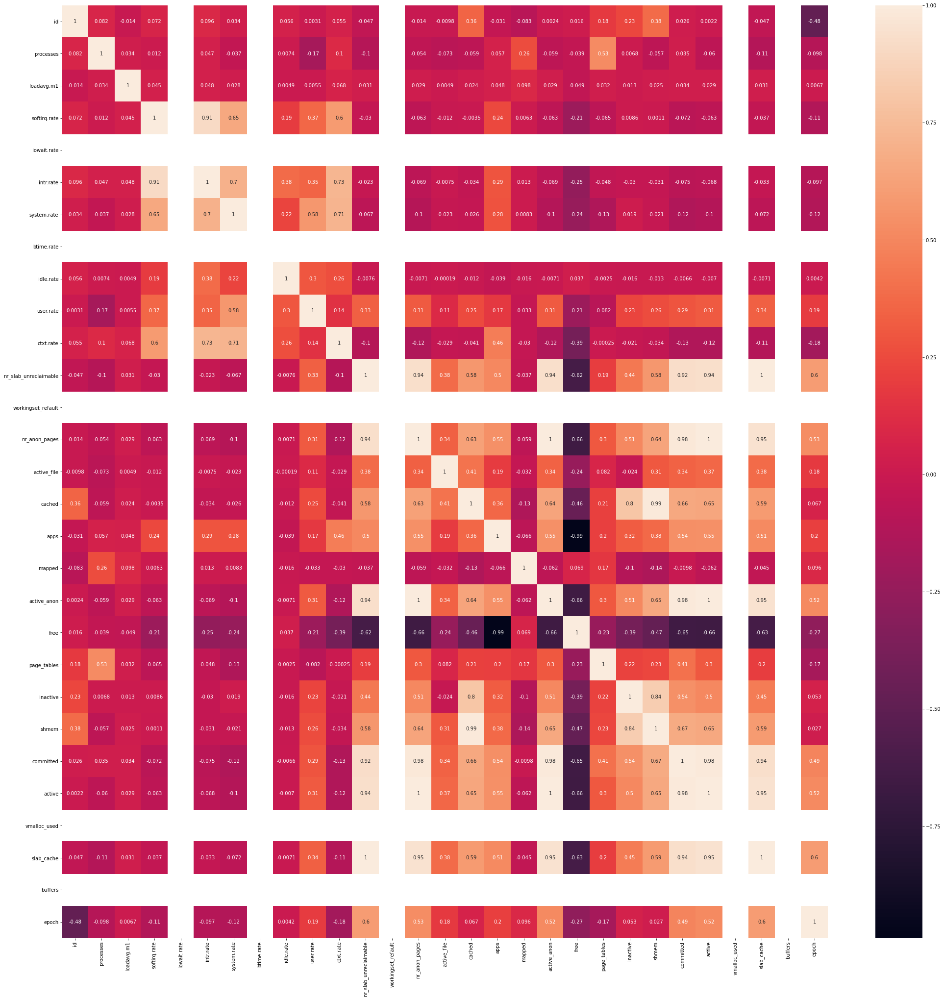

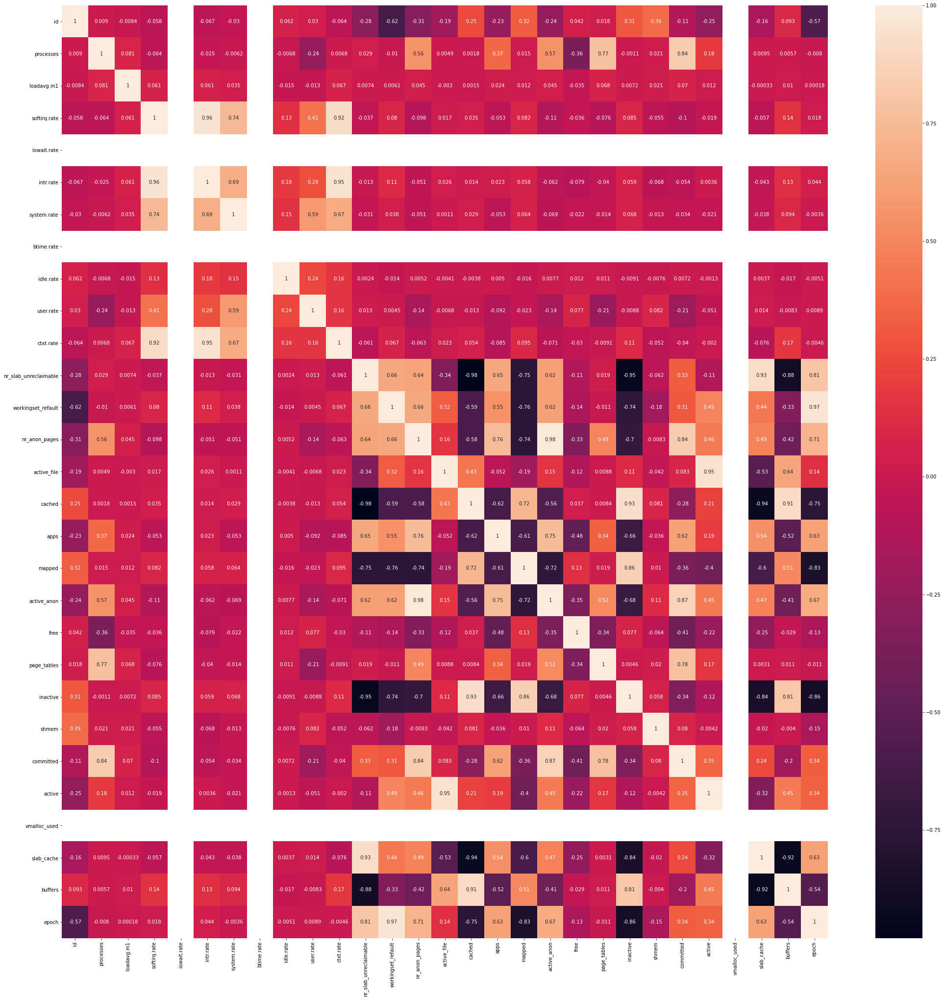

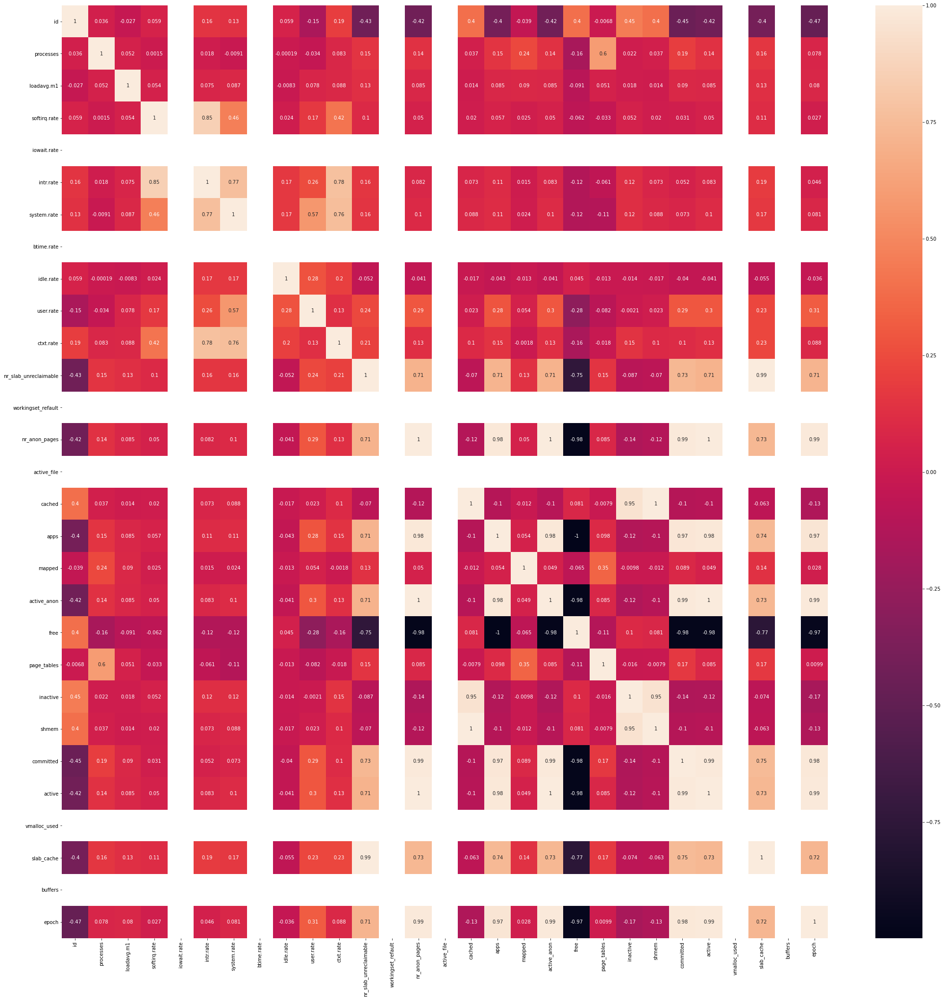

...

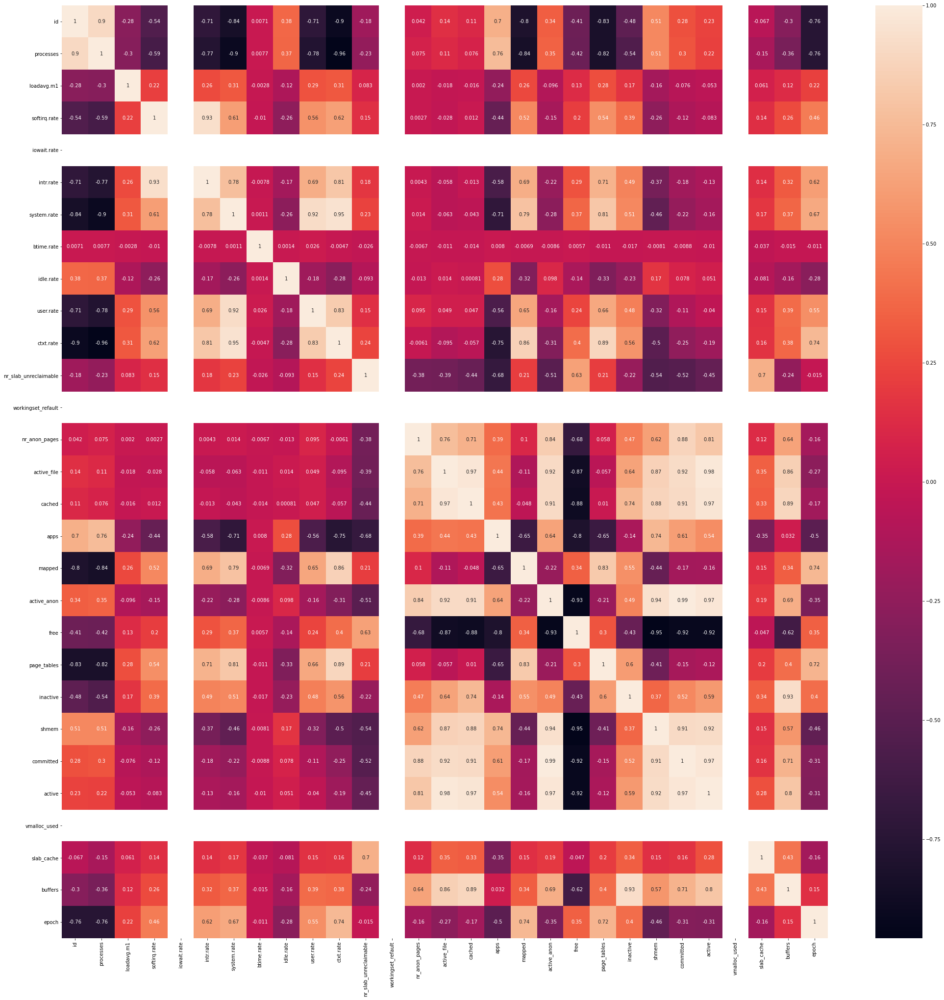

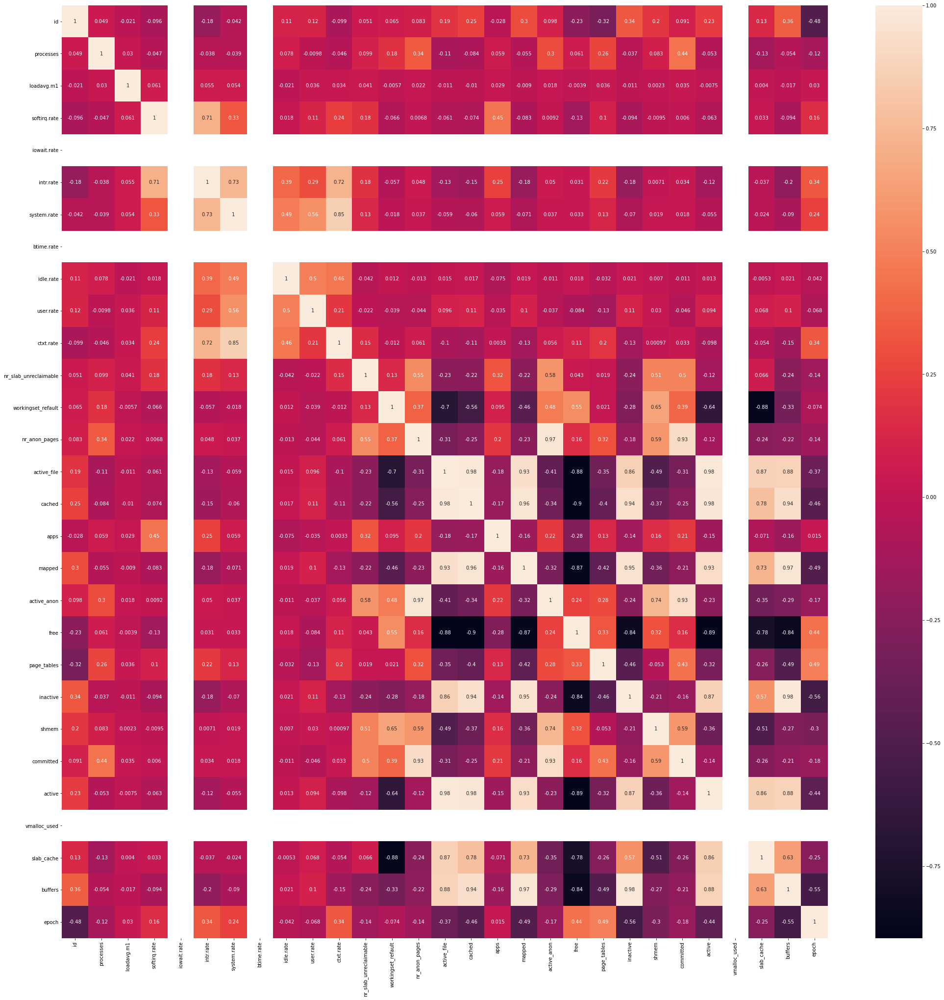

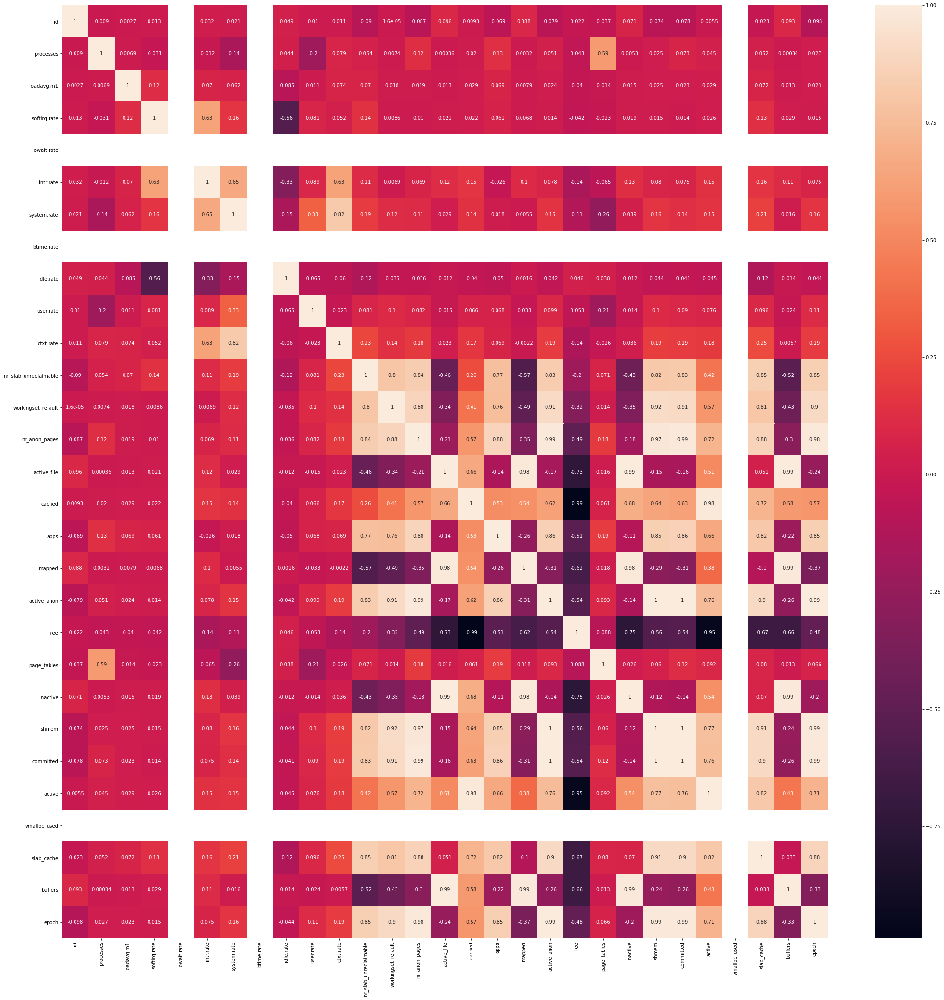

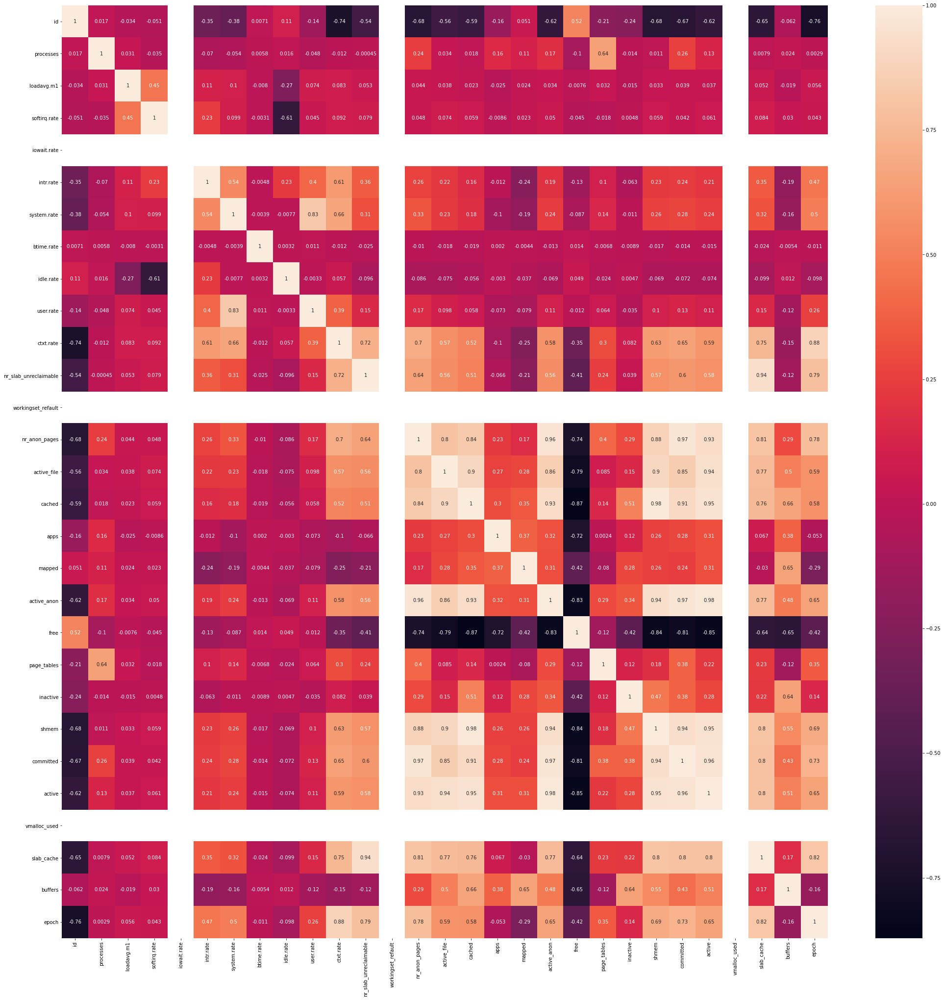

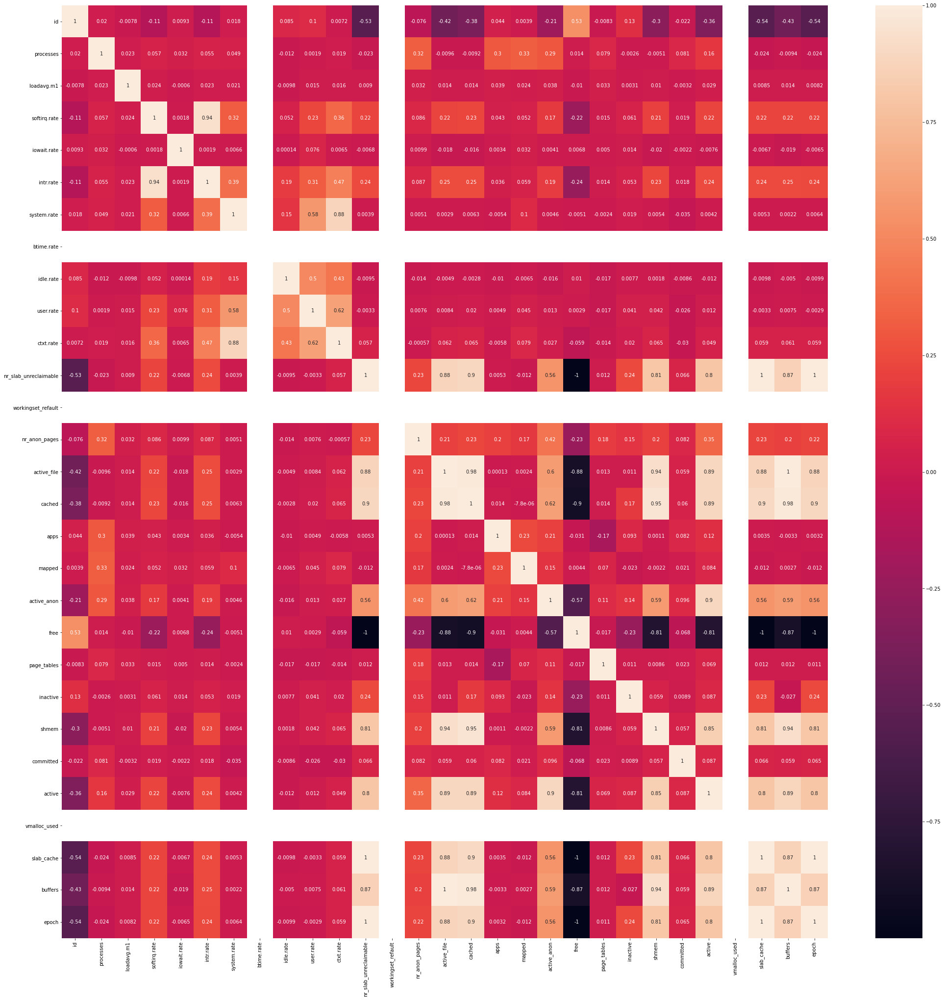

In [30]:
for df in list_df:
    # Pearson correlation
    plt.subplots(figsize=(35, 35))
    sns.heatmap(df.corr(), annot=True)
    plt.show()


Anomalies in dataset of size 8480 found: 85
Anomalies2 in dataset of size 8480 found: 85
Initial shape: (8480, 29)
PCA data shape: (8480, 2)


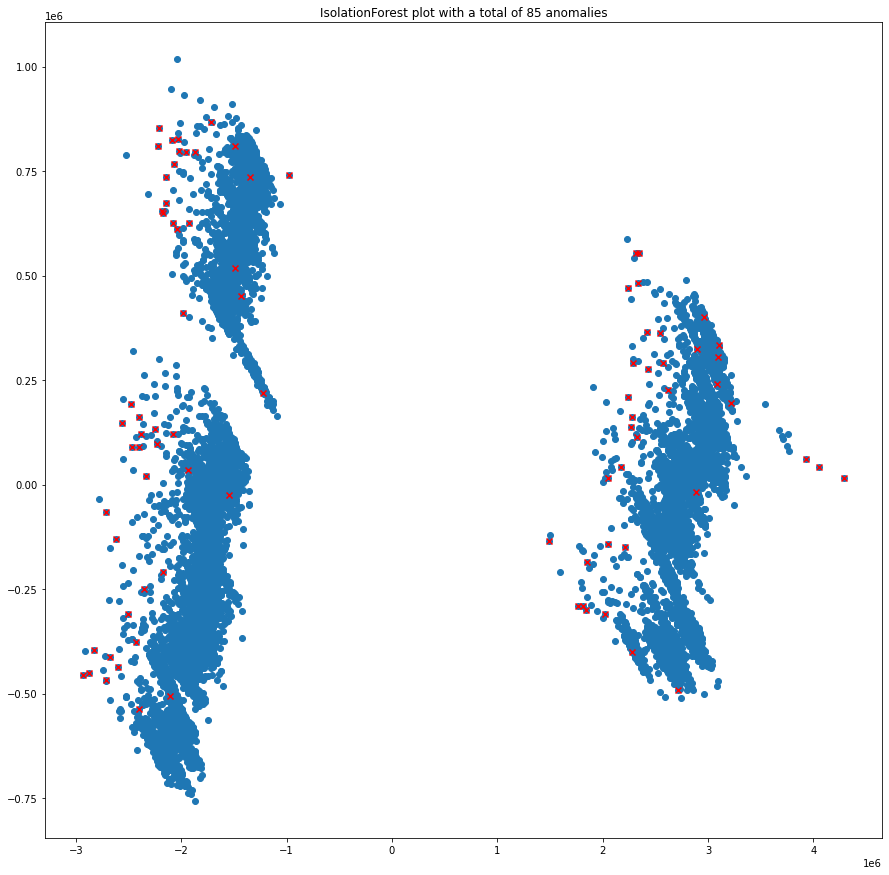

In [31]:
# Initial IsolationForest
dataset_raw = list_df[0].drop(["date"], axis=1)

# # Data preprocessing options
# transformer = PCA(n_components=2)
# transformer.fit(dataset_raw)
# X_transformed = transformer.transform(dataset_raw)
# print(X_transformed.shape)
# dataset_rf  = X_transformed

dataset_rf  = dataset_raw
# Parameters
contamination = 0.01
# contamination = "auto"

clf_if = IsolationForest(n_estimators=10, warm_start=True, contamination=contamination)
clf_if.fit(dataset_rf)
pred = clf_if.predict(dataset_rf)
clf_if.set_params(n_estimators=100)
clf_if.fit(dataset_rf)
pred2 = clf_if.predict(dataset_rf)
print("Anomalies in dataset of size {} found: {}".format(len(list(pred)),list(pred).count(-1)))
print("Anomalies2 in dataset of size {} found: {}".format(len(list(pred2)),list(pred2).count(-1)))

# Get anomaly index and the values based on said index
anomaly_index_rf = np.where(pred==-1)

transformer = PCA(n_components=2)
transformer.fit(dataset_raw)
X_transformed = transformer.transform(dataset_raw)
print("Initial shape: {}".format(dataset_raw.shape))
print("PCA data shape: {}".format(X_transformed.shape))
dataset_rf  = X_transformed

# Get anomalies based on index
values_rf = dataset_rf[anomaly_index_rf]

#Plot prediction on 2d
fig = plt.figure(figsize=(15,15))
plt.scatter(dataset_rf[:,0], dataset_rf[:,1])
plt.scatter(values_rf[:,0], values_rf[:,1], color='r', marker='x')
plt.title("IsolationForest plot with a total of {} anomalies".format(list(pred).count(-1)))
plt.show()

(8480, 3)


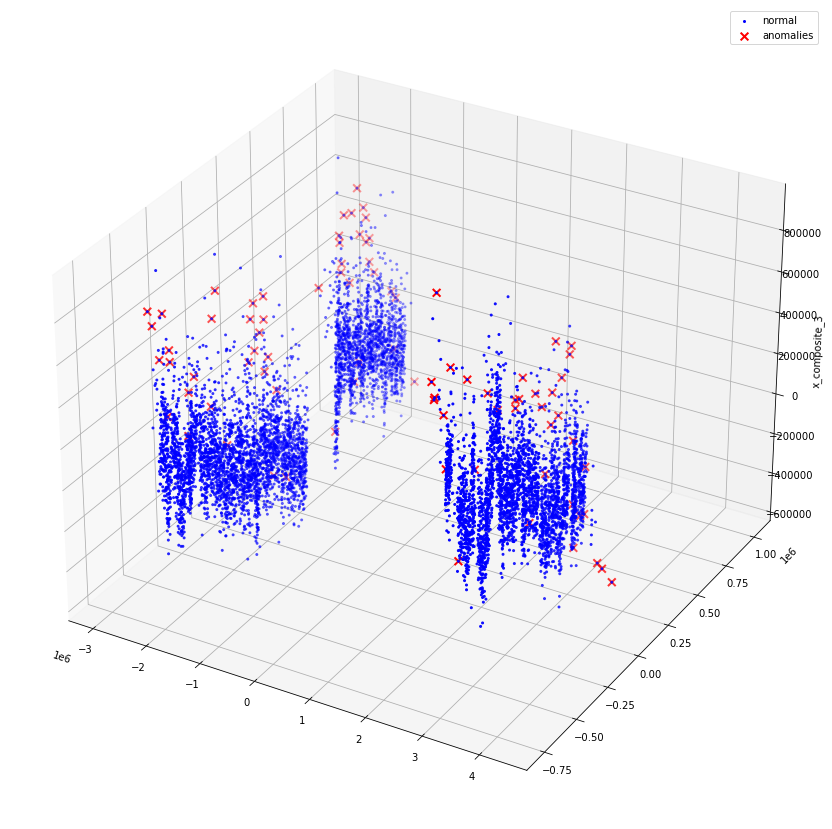

In [32]:
# Data preprocessing options (3d)
transformer = PCA(n_components=3)
transformer.fit(dataset_raw)
X_transformed_3d = transformer.transform(dataset_raw)
print(X_transformed_3d.shape)


# Plot 3D anomaly map
fig = plt.figure(figsize=(15,15))

ax = fig.add_subplot(111, projection='3d')
ax.set_zlabel("x_composite_3")
# Plot the compressed data points
ax.scatter(X_transformed_3d[:, 0], X_transformed_3d[:, 1], zs=X_transformed_3d[:, 2], s=4, lw=1, label="normal",c="blue")
# Plot x's for the ground truth outliers
ax.scatter(X_transformed_3d[anomaly_index_rf,0],X_transformed_3d[anomaly_index_rf,1], X_transformed_3d[anomaly_index_rf,2],
           lw=2, s=60, marker="x", c="red", label="anomalies")
ax.legend()
plt.show()


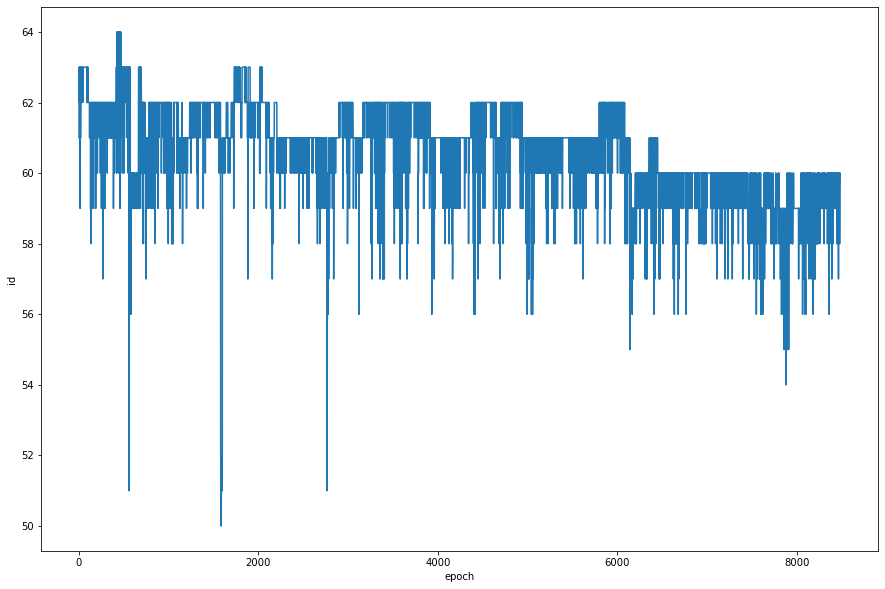

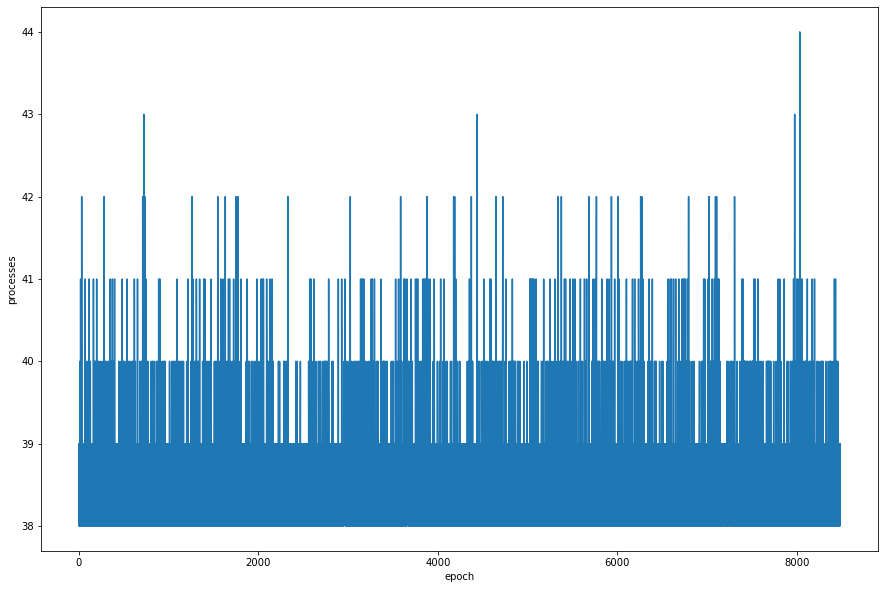

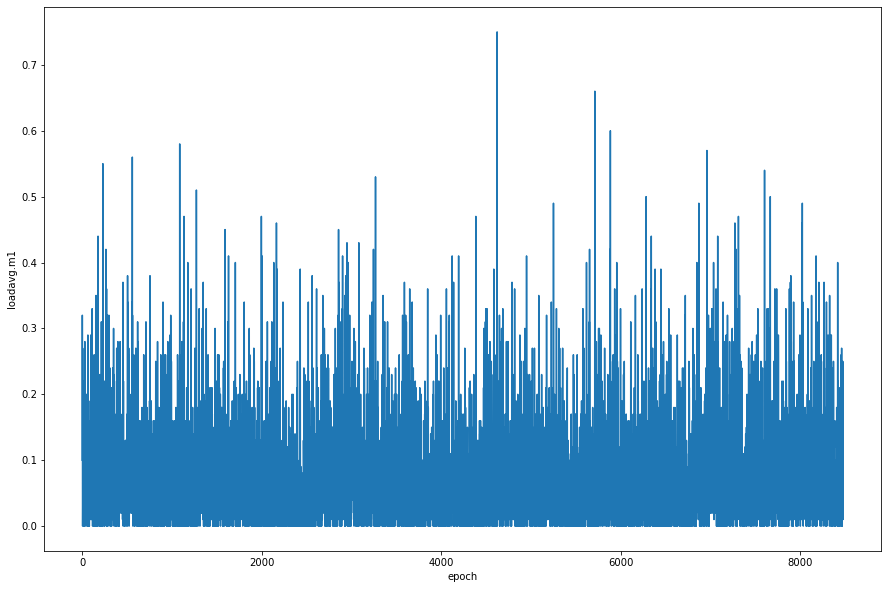

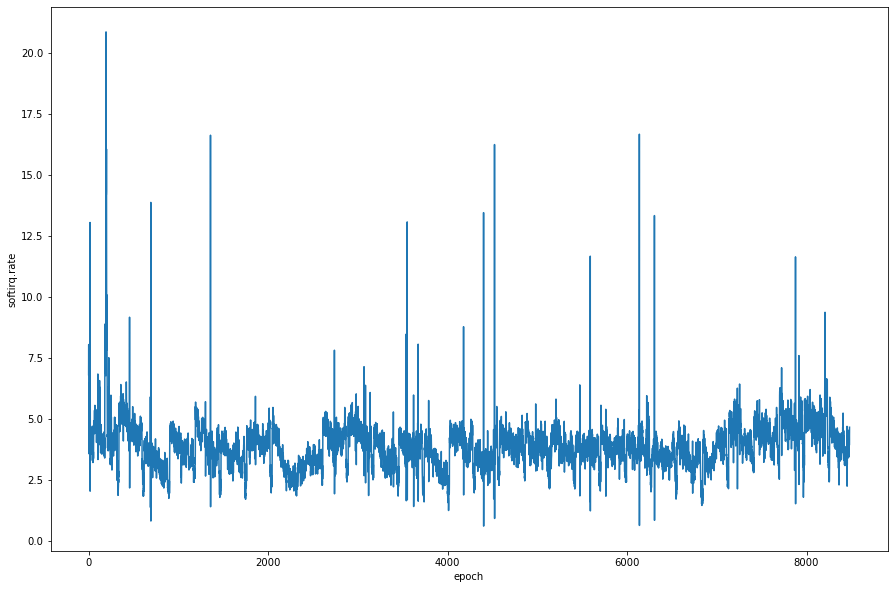

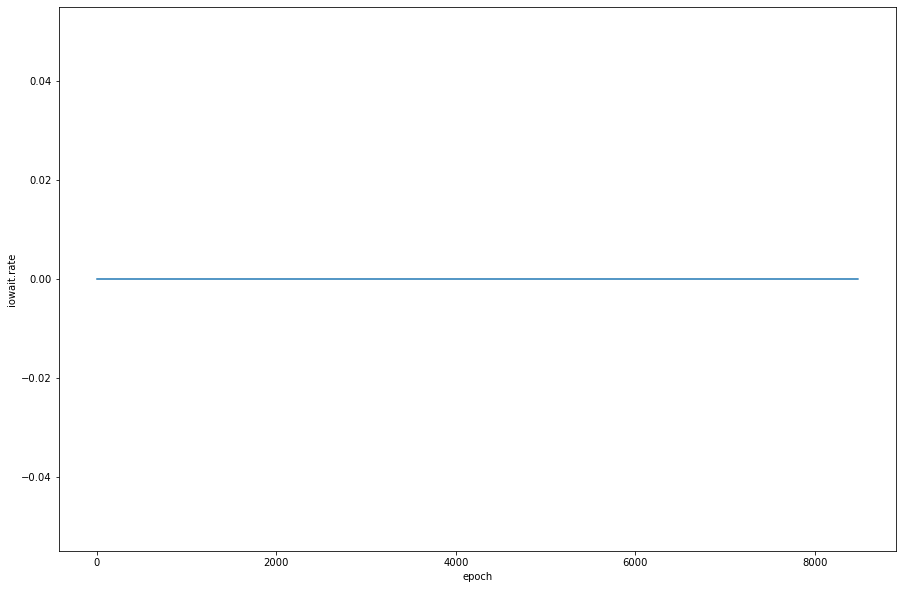

...

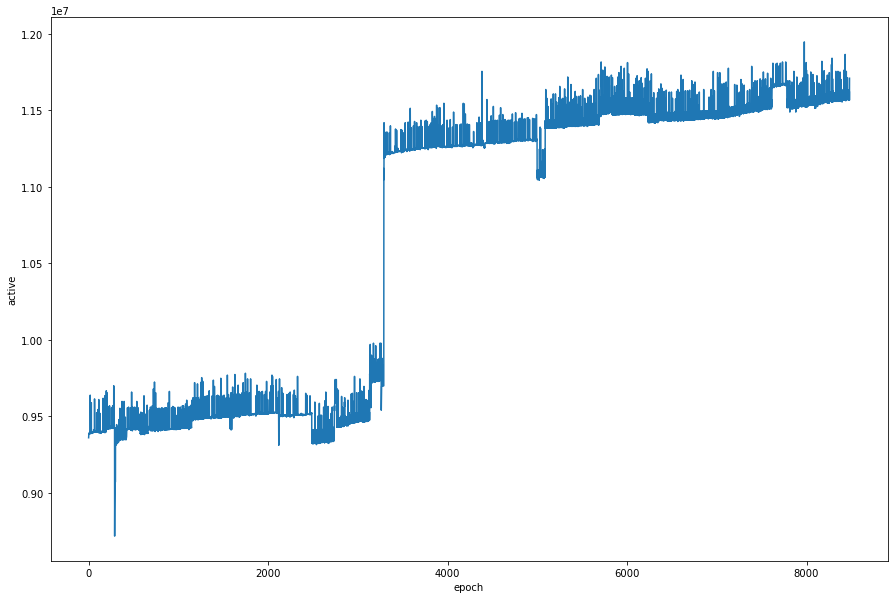

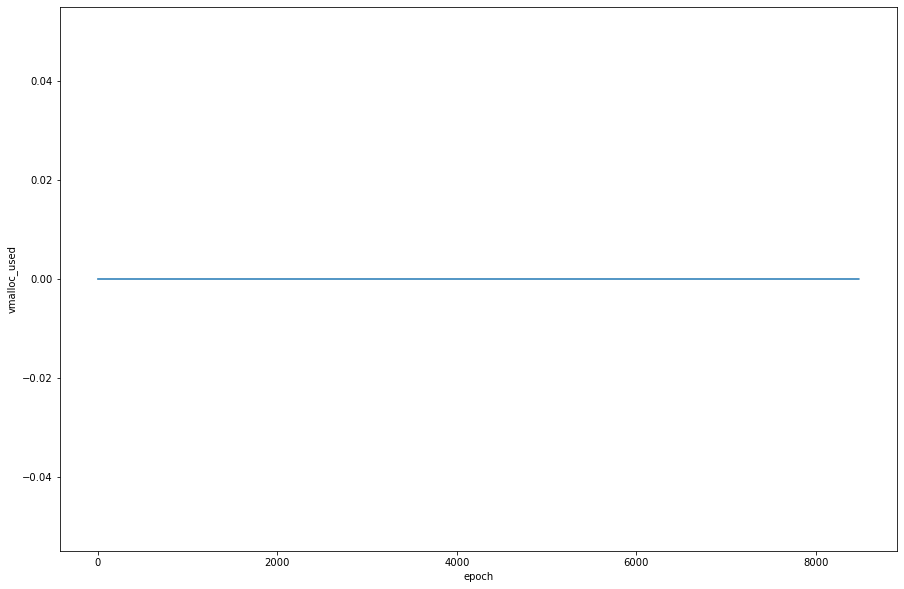

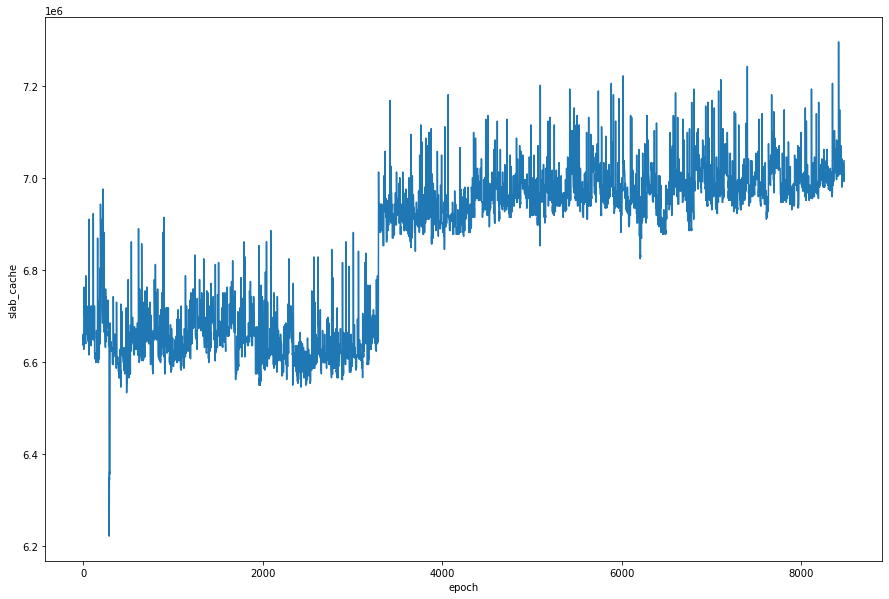

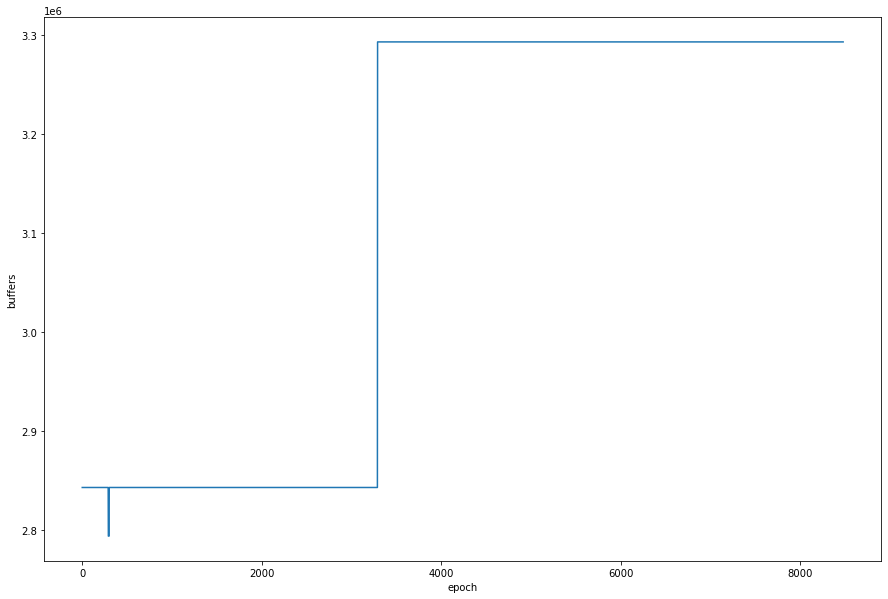

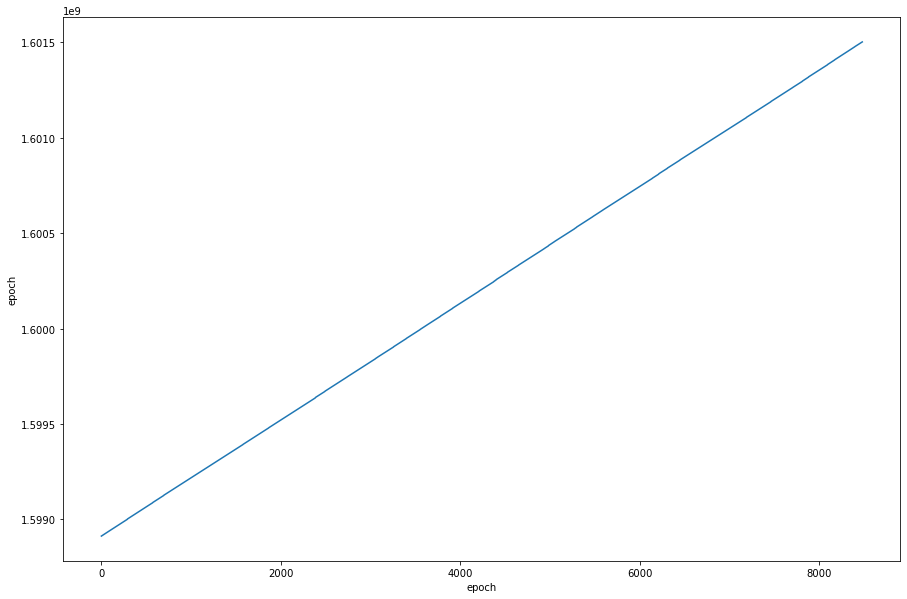

In [33]:
# Add anomalies to all columns from raw dataframe
for col in dataset_raw.columns:
    plt.figure(figsize=(15,10))
    fig = dataset_raw[col].plot()
    fig.set_ylabel(col)
    fig.set_xlabel('epoch')
    plt.show()

['id' 'processes' 'loadavg.m1' 'softirq.rate' 'iowait.rate' 'intr.rate'
 'system.rate' 'btime.rate' 'idle.rate' 'user.rate' 'ctxt.rate'
 'nr_slab_unreclaimable' 'workingset_refault' 'nr_anon_pages'
 'active_file' 'cached' 'apps' 'mapped' 'active_anon' 'free' 'page_tables'
 'inactive' 'shmem' 'committed' 'active' 'vmalloc_used' 'slab_cache'
 'buffers' 'epoch']


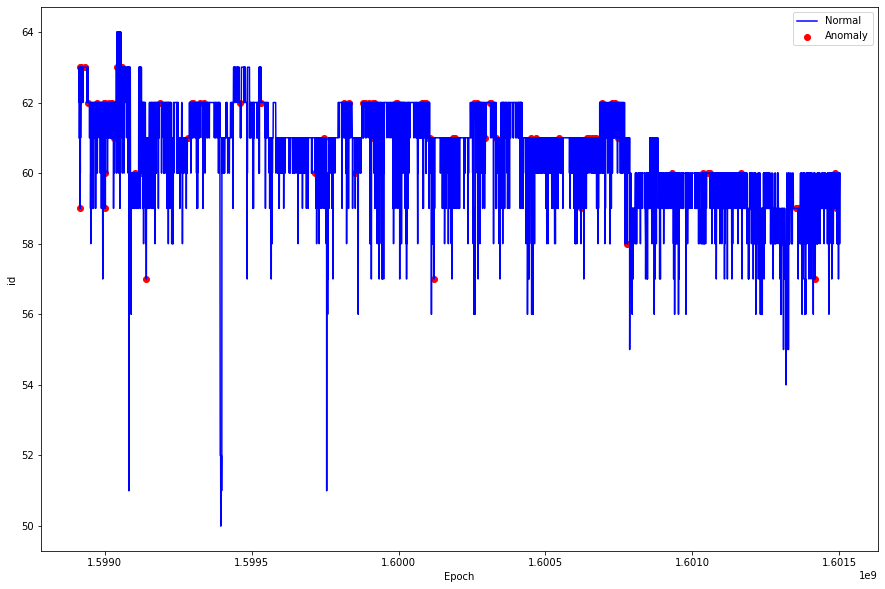

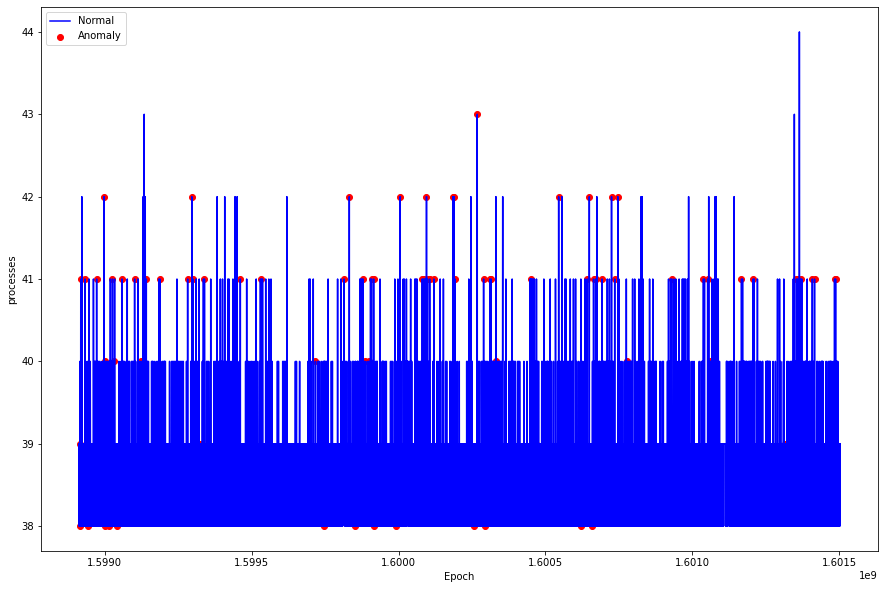

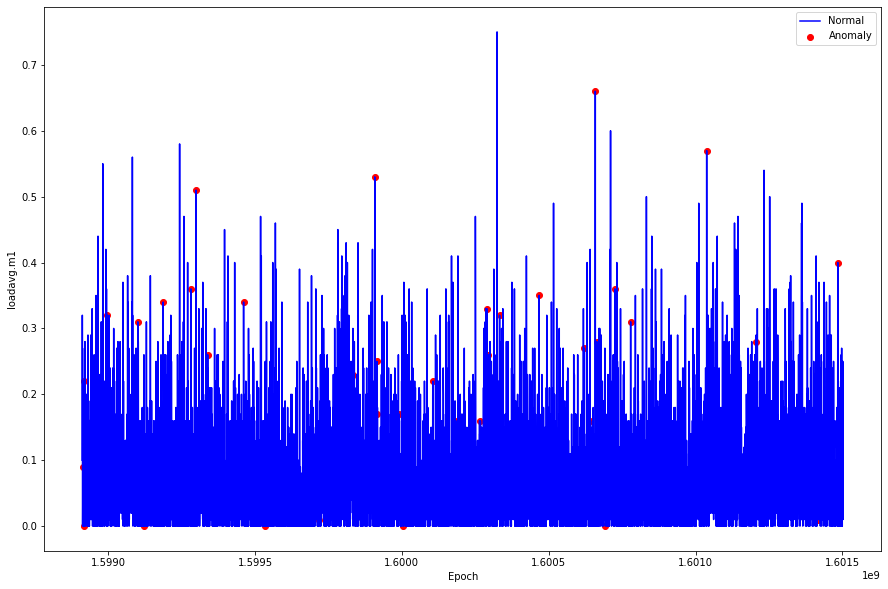

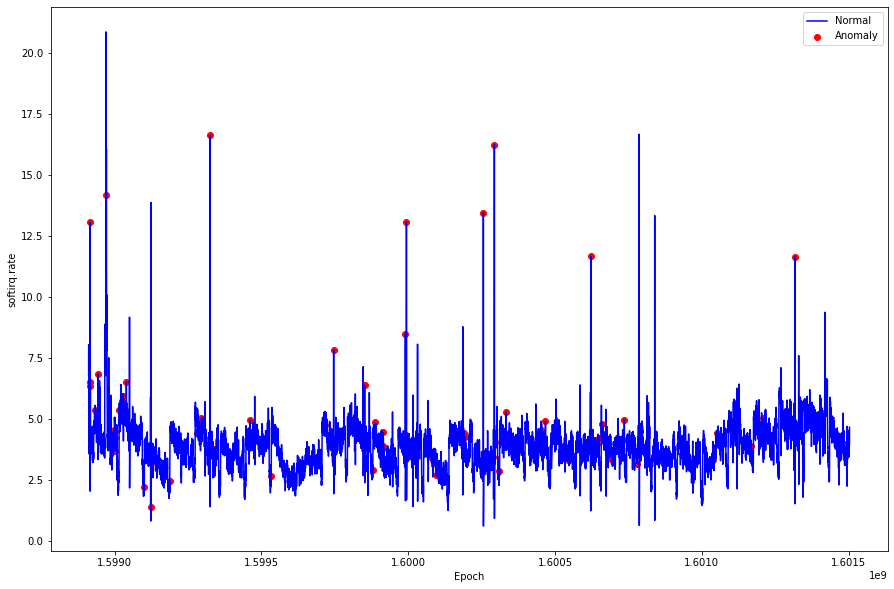

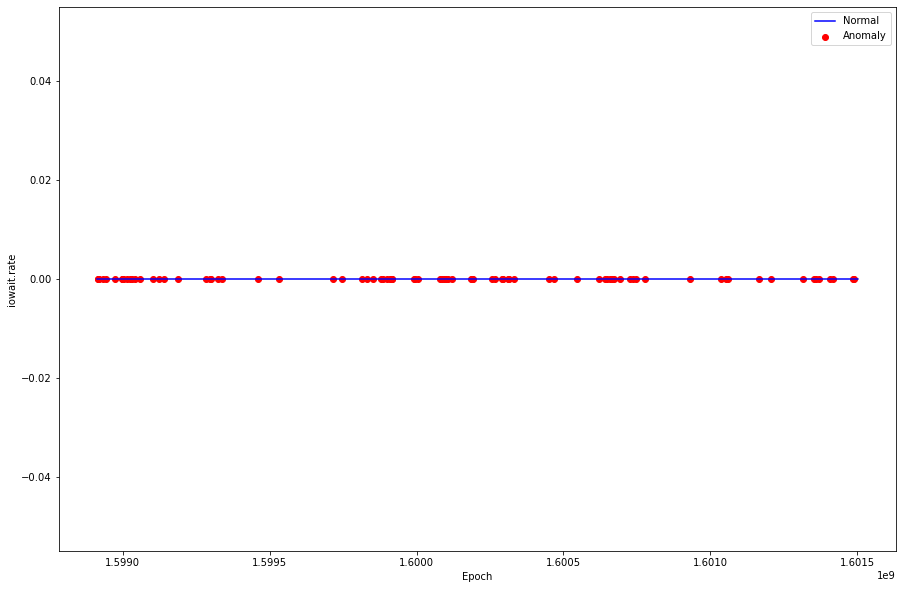

...

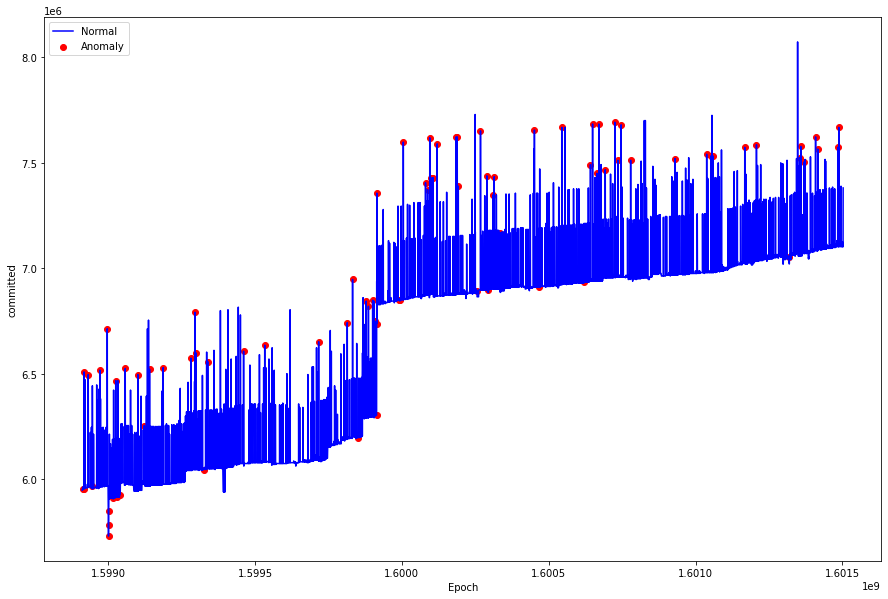

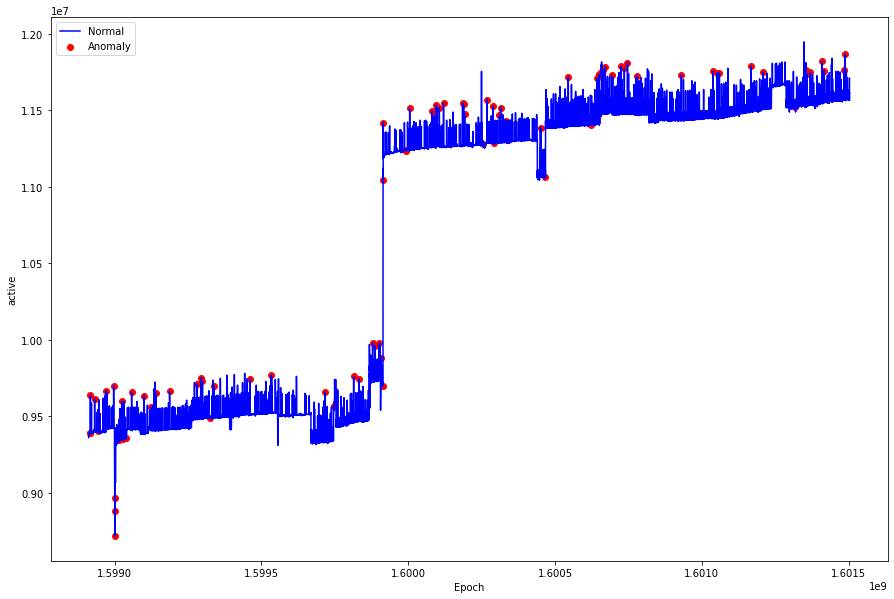

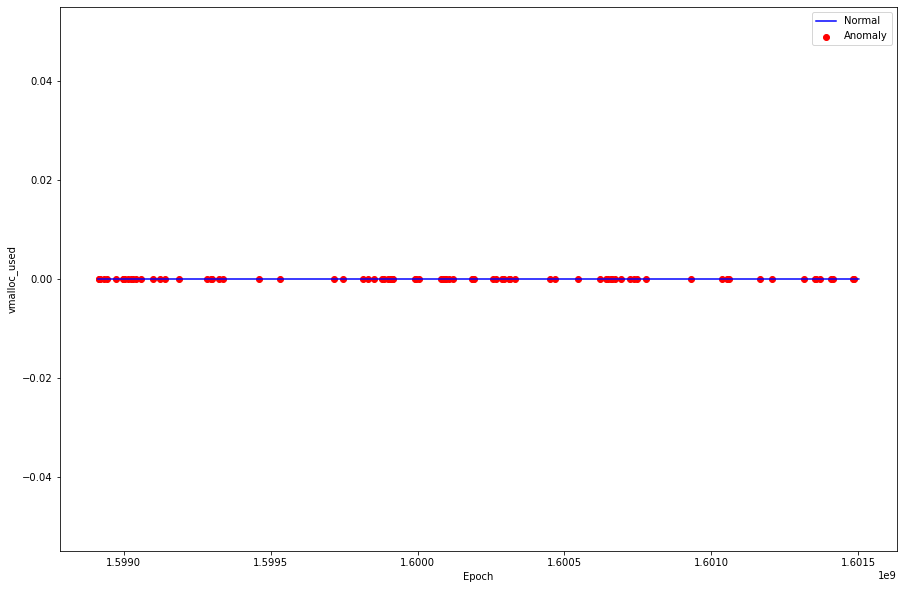

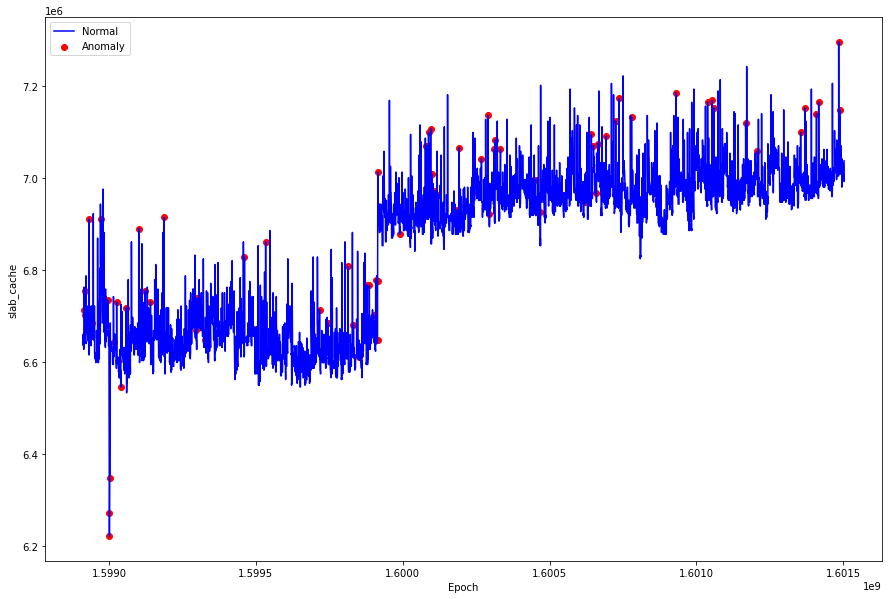

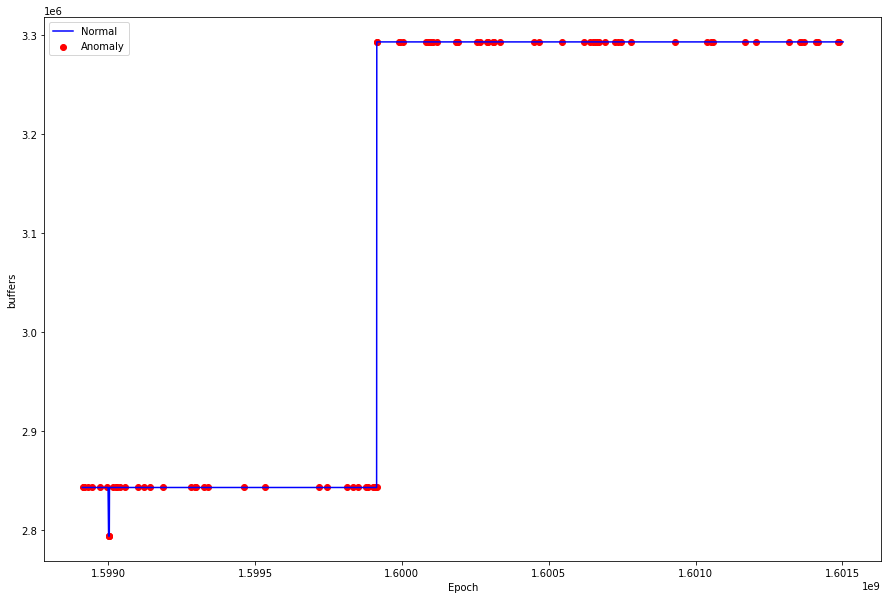

In [34]:
# Add anomalies to all columns from raw dataframe

df_plot = dataset_raw
print(df_plot.columns.values)
col_names_plt = list(df_plot.columns.values)
df_plot['anomaly'] = pred

for feature in col_names_plt:
    if feature == 'epoch' or feature == 'anomaly':
        pass
    else:
        fig, ax = plt.subplots(figsize=(15,10))
        a = df_plot.loc[df_plot['anomaly'] == -1, ['epoch', feature]] #anomaly
        ax.plot(df_plot['epoch'], df_plot[feature], color='blue', label='Normal')
        ax.scatter(a['epoch'],a[feature], color='red', label='Anomaly')
        plt.xlabel('Epoch')
        plt.ylabel(feature)
        plt.legend()
        plt.show();

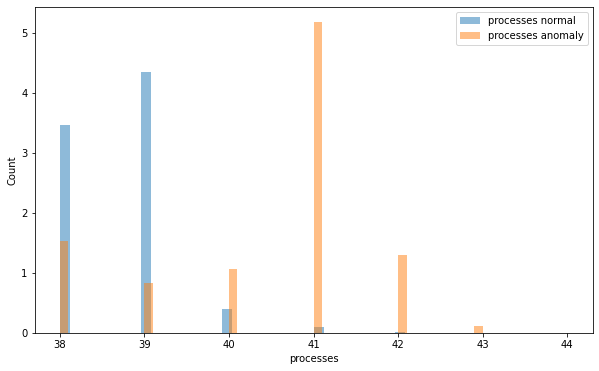

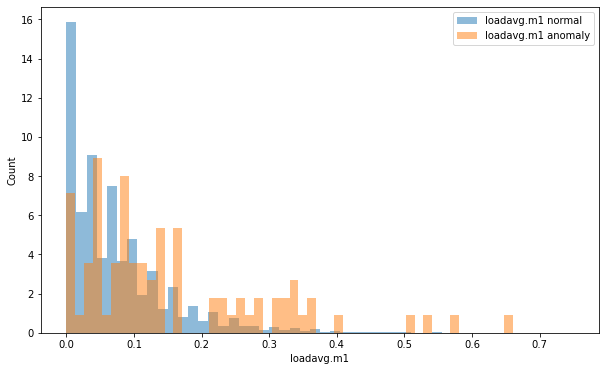

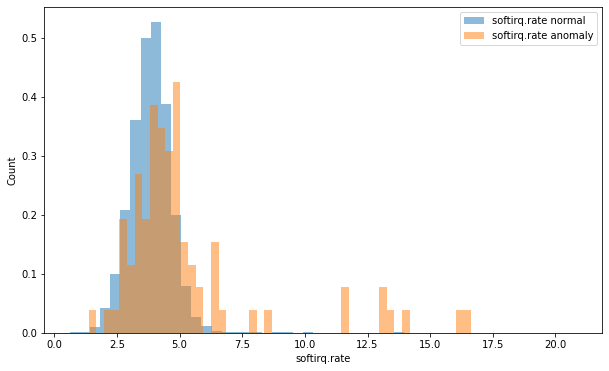

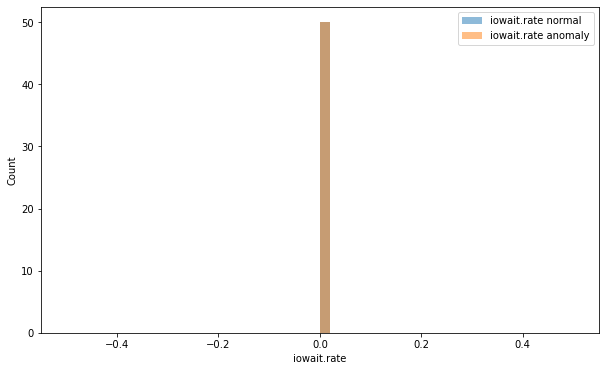

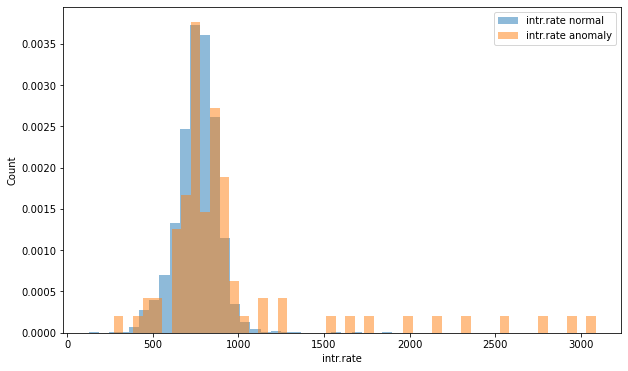

...

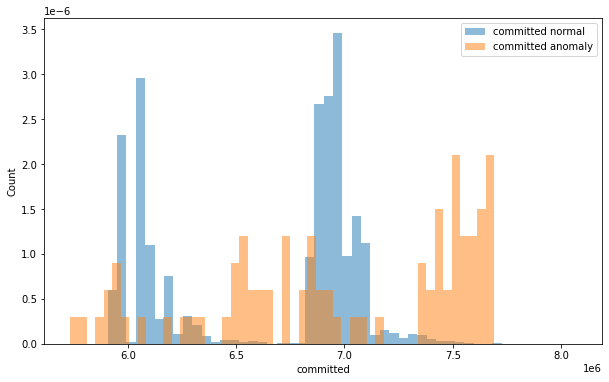

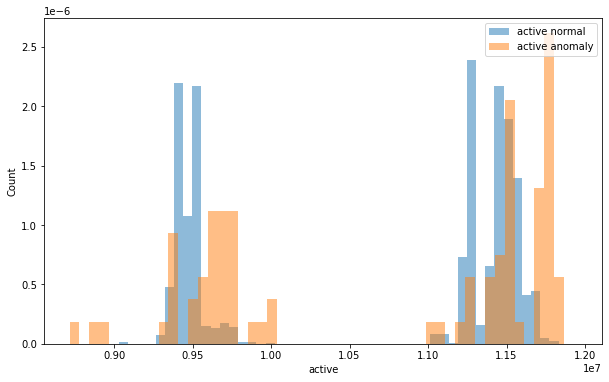

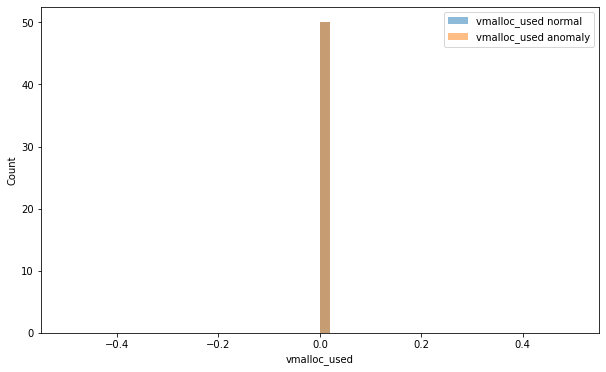

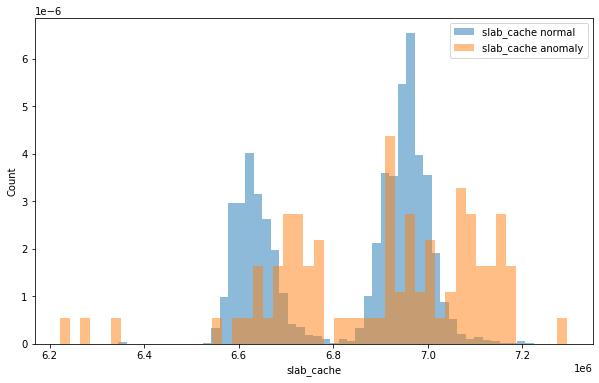

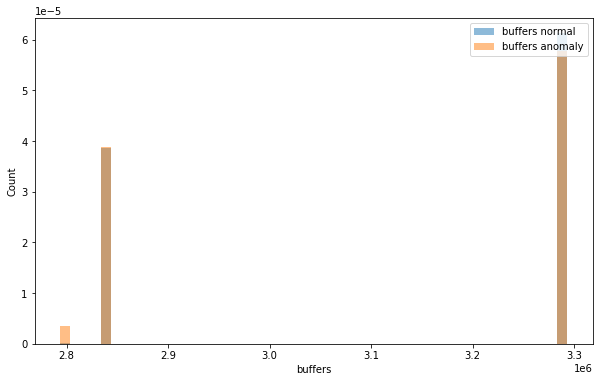

In [35]:
# Feature separability (normalized)
# print(df_plot.columns.values)
for feature in col_names_plt:
    if feature == 'epoch' or feature == 'anomaly' or feature == 'id':
        pass
    else:
        normal_event = df_plot.loc[df_plot['anomaly'] == 1, feature]
        anomay_event = df_plot.loc[df_plot['anomaly'] == -1, feature]

        plt.figure(figsize=(10, 6))
        plt.hist(normal_event, bins = 50, alpha=0.5, density=True,label='{} normal'.format(feature))
        plt.hist(anomay_event, bins = 50, alpha=0.5, density=True, label='{} anomaly'.format(feature))
        plt.legend(loc='upper right')
        plt.xlabel(feature)
        plt.ylabel('Count')
        plt.show();

In [36]:
# Define nine outlier detection tools to be compared

# initialize a set of detectors for LSCP
detector_list = [LOF(n_neighbors=5), LOF(n_neighbors=10), LOF(n_neighbors=15),
                 LOF(n_neighbors=20), LOF(n_neighbors=25), LOF(n_neighbors=30),
                 LOF(n_neighbors=35), LOF(n_neighbors=40), LOF(n_neighbors=45),
                 LOF(n_neighbors=50)]
# Parameters
contamination_est = 0.01
random_state = np.random.RandomState(42)
anomaly_label = 1
# random_state  =42
classifiers = {
    'Angle-based Outlier Detector (ABOD)':
        ABOD(contamination=contamination_est),
    'Cluster-based Local Outlier Factor (CBLOF)':
        CBLOF(contamination=contamination_est,
              check_estimator=False, random_state=random_state),
    'Feature Bagging':
        FeatureBagging(LOF(n_neighbors=35),
                       contamination=contamination_est,
                       random_state=random_state),
    'Histogram-base Outlier Detection (HBOS)': HBOS(
        contamination=contamination_est),
    'Isolation Forest': IForest(contamination=contamination_est,
                                random_state=random_state),
    'K Nearest Neighbors (KNN)': KNN(
        contamination=contamination_est),
    'Average KNN': KNN(method='mean',
                       contamination=contamination_est),
    'Local Outlier Factor (LOF)':
        LOF(n_neighbors=35, contamination=contamination_est),
    'Minimum Covariance Determinant (MCD)': MCD(
        contamination=contamination_est, random_state=random_state),
    'One-class SVM (OCSVM)': OCSVM(contamination=contamination_est),
    'Locally Selective Combination (LSCP)': LSCP(
        detector_list, contamination=contamination_est,
        random_state=random_state)
}
# Show all detectors
for i, clf in enumerate(classifiers.keys()):
    print('Model', i + 1, clf)

Model 1 Angle-based Outlier Detector (ABOD)
Model 2 Cluster-based Local Outlier Factor (CBLOF)
Model 3 Feature Bagging
Model 4 Histogram-base Outlier Detection (HBOS)
Model 5 Isolation Forest
Model 6 K Nearest Neighbors (KNN)
Model 7 Average KNN
Model 8 Local Outlier Factor (LOF)
Model 9 Minimum Covariance Determinant (MCD)
Model 10 One-class SVM (OCSVM)
Model 11 Locally Selective Combination (LSCP)


In [37]:
dataset_cmp = list_df[0].drop(["date"], axis=1)
dataset_cmp

,id,processes,loadavg.m1,softirq.rate,iowait.rate,intr.rate,system.rate,btime.rate,idle.rate,user.rate,...,free,page_tables,inactive,shmem,committed,active,vmalloc_used,slab_cache,buffers,epoch
0,61,39,0.10,6.813333,0,946.333333,2.880000,0,78.503333,2.180000,...,34611200,290816,3805184,835584,5947392,9359360,0,6639616,2842624,1598911800
1,63,38,0.32,8.046667,0,1121.523333,3.036667,0,88.583333,2.246667,...,34492416,294912,3805184,835584,5947392,9371648,0,6660096,2842624,1598912100
2,63,38,0.11,5.504983,0,907.152824,2.830565,0,88.694352,2.272425,...,34418688,303104,3813376,835584,5955584,9383936,0,6635520,2842624,1598912400
3,63,39,0.10,4.581940,0,881.150502,3.304348,0,96.632107,2.642140,...,34430976,303104,3809280,835584,5955584,9388032,0,6643712,2842624,1598912701
4,62,39,0.00,3.573333,0,758.266667,2.616667,0,85.783333,1.863333,...,34516992,299008,3809280,835584,5955584,9388032,0,6651904,2842624,1598913000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8475,59,38,0.25,4.548495,0,960.317726,3.775920,0,102.240803,2.591973,...,31670272,327680,4235264,1064960,7122944,11632640,0,6995968,3293184,1601501401
8476,58,39,0.03,4.080000,0,746.280000,2.813333,0,78.506667,1.973333,...,31657984,327680,4231168,1044480,7102464,11567104,0,6991872,3293184,1601501700
8477,59,39,0.01,3.926667,0,798.123333,3.343333,0,83.550000,2.626667,...,31563776,327680,4231168,1052672,7110656,11624448,0,6991872,3293184,1601502000
8478,60,38,0.20,4.143333,0,828.853333,3.463333,0,90.430000,3.036667,...,31404032,327680,4231168,1044480,7102464,11567104,0,6991872,3293184,1601502300


1 fitting Angle-based Outlier Detector (ABOD)
Completed Angle-based Outlier Detector (ABOD) training in:  4.113540887832642
Completed Angle-based Outlier Detector (ABOD) prediction in:  1.4385828971862793
Initial shape: (8480, 30)
PCA data shape: (8480, 2)
[0 0 0 ... 0 0 1]
Anomalies in dataset of size 8480 found: 87
(8480, 3)
2 fitting Cluster-based Local Outlier Factor (CBLOF)
Completed Cluster-based Local Outlier Factor (CBLOF) training in:  0.12911009788513184
Completed Cluster-based Local Outlier Factor (CBLOF) prediction in:  0.0014121532440185547
Initial shape: (8480, 30)
PCA data shape: (8480, 2)
[0 0 0 ... 0 0 0]
Anomalies in dataset of size 8480 found: 85
(8480, 3)
3 fitting Feature Bagging
Completed Feature Bagging training in:  0.6076412200927734
Completed Feature Bagging prediction in:  0.39886999130249023
Initial shape: (8480, 30)
PCA data shape: (8480, 2)
[0 0 0 ... 0 0 0]
Anomalies in dataset of size 8480 found: 72
(8480, 3)
4 fitting Histogram-base Outlier Detection (H

No handles with labels found to put in legend.
/Users/Gabriel/anaconda3/envs/dipet/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
/Users/Gabriel/anaconda3/envs/dipet/lib/python3.7/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/Gabriel/anaconda3/envs/dipet/

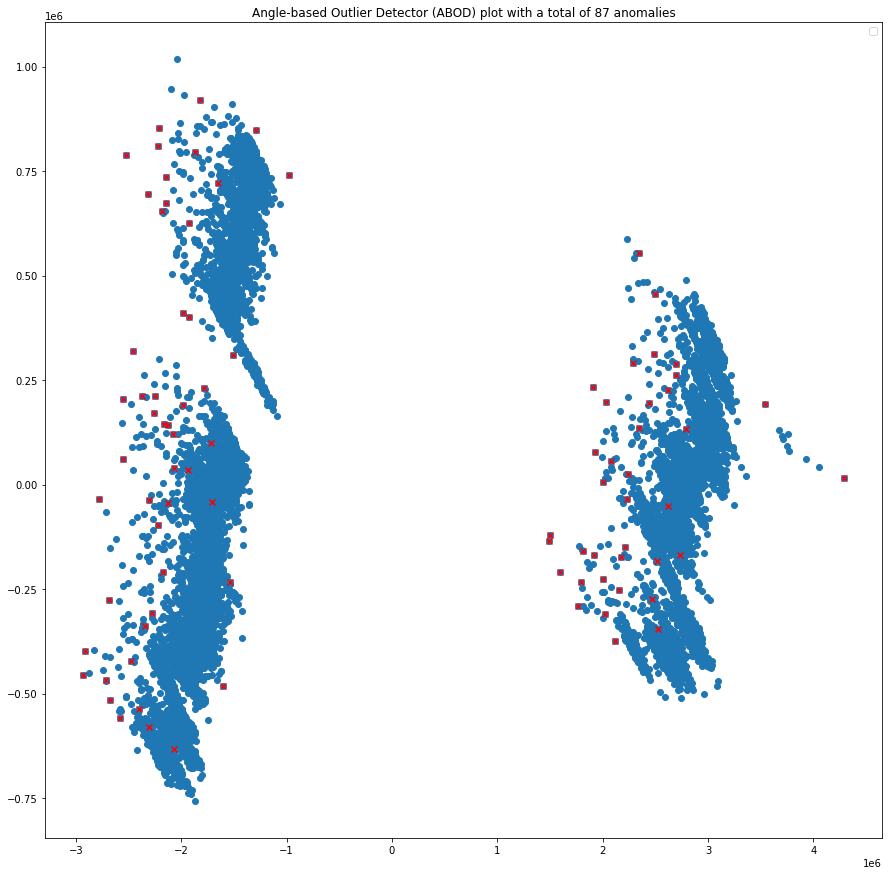

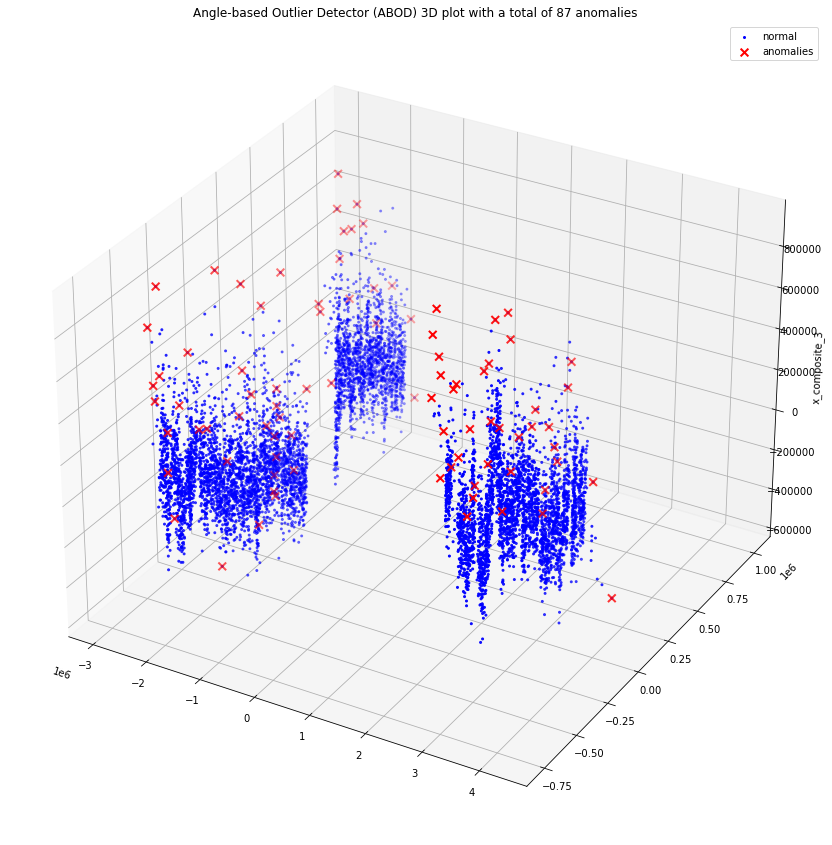

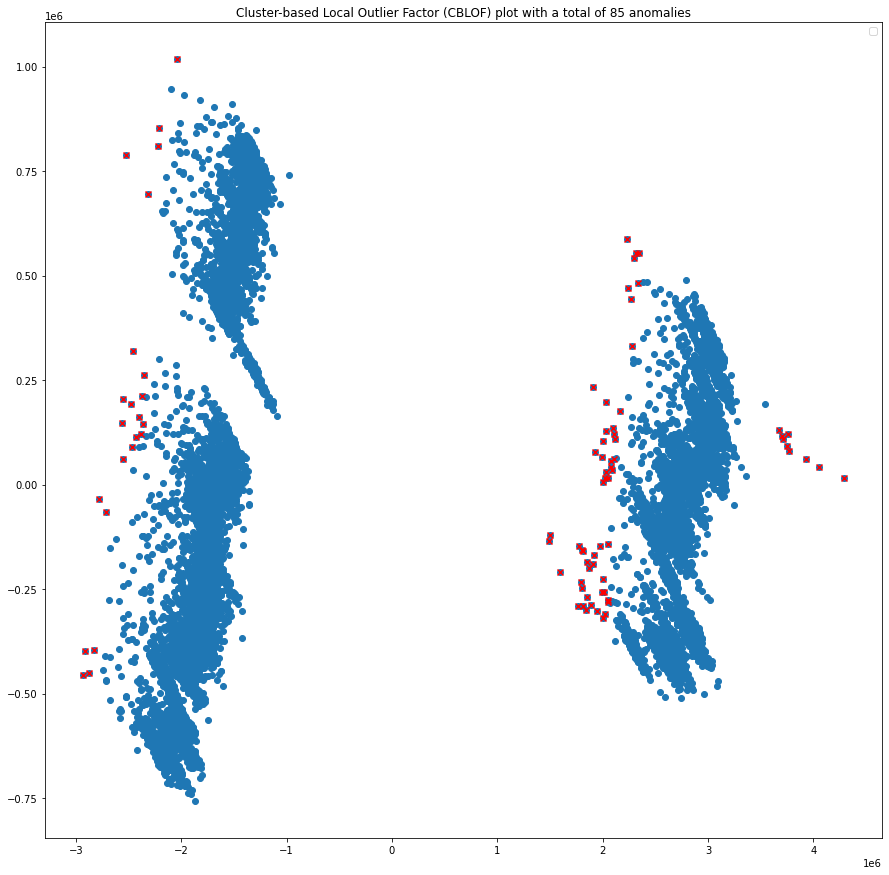

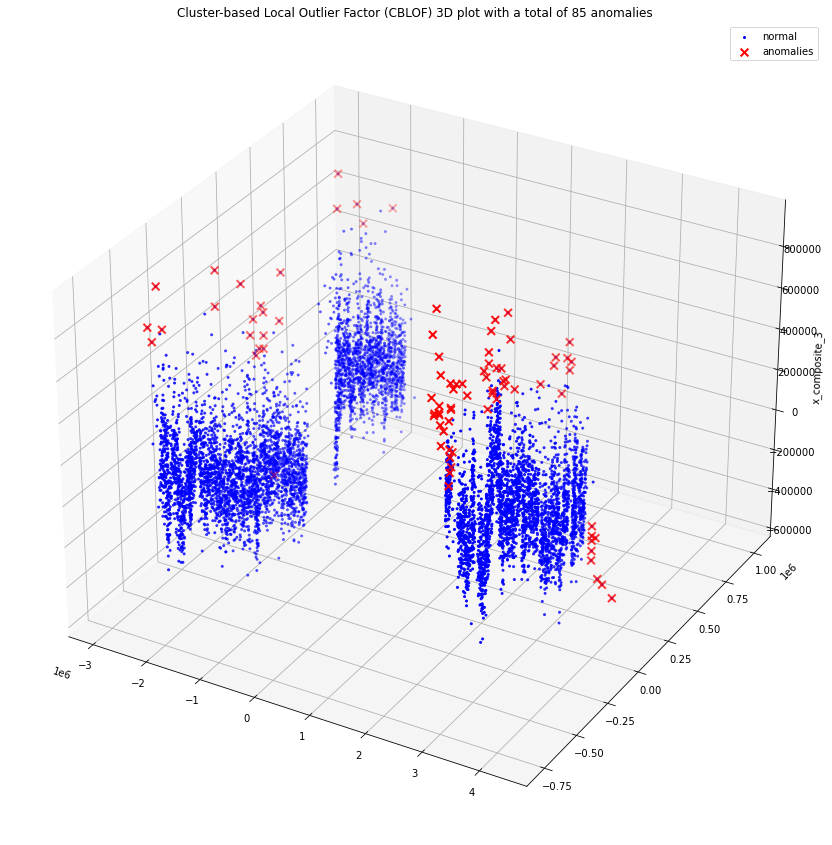

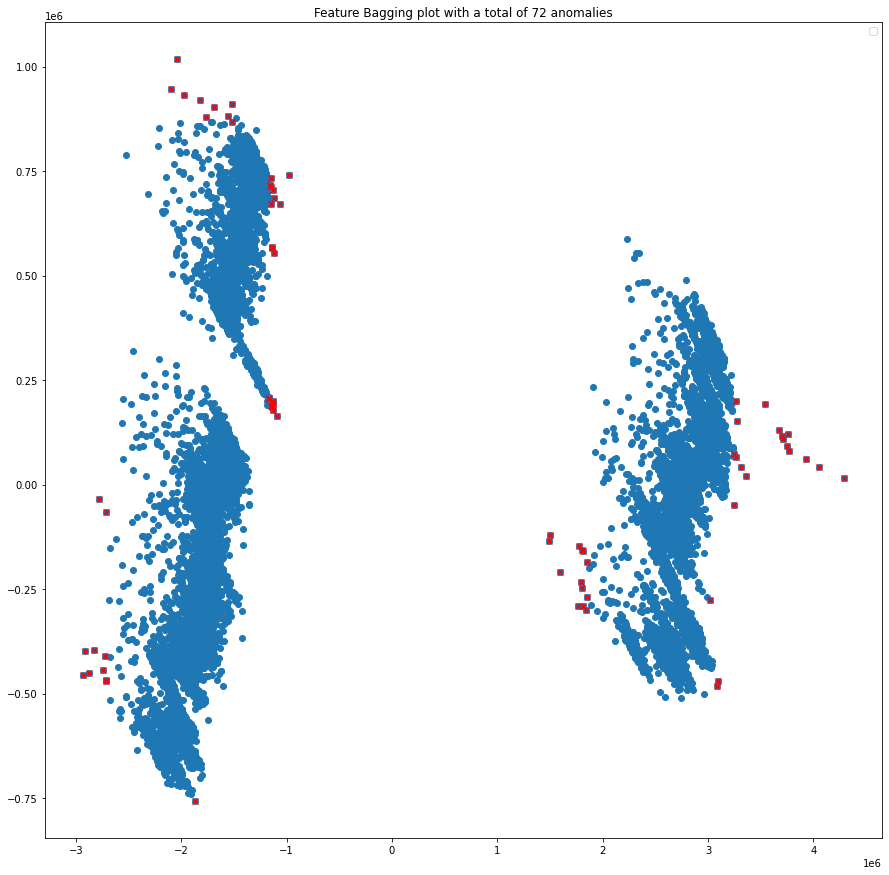

...

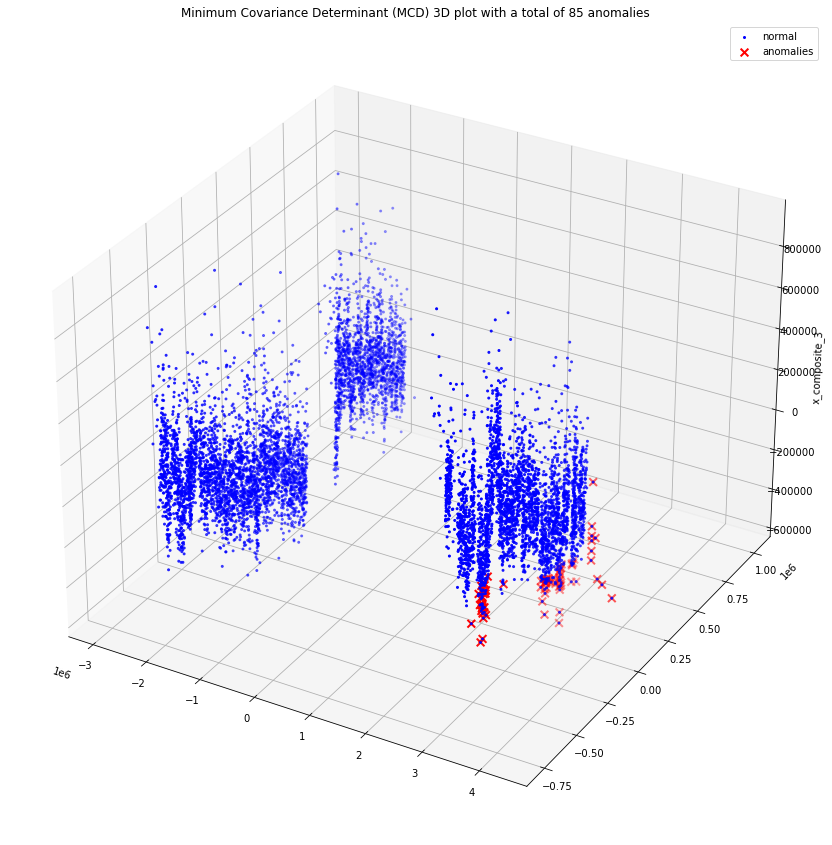

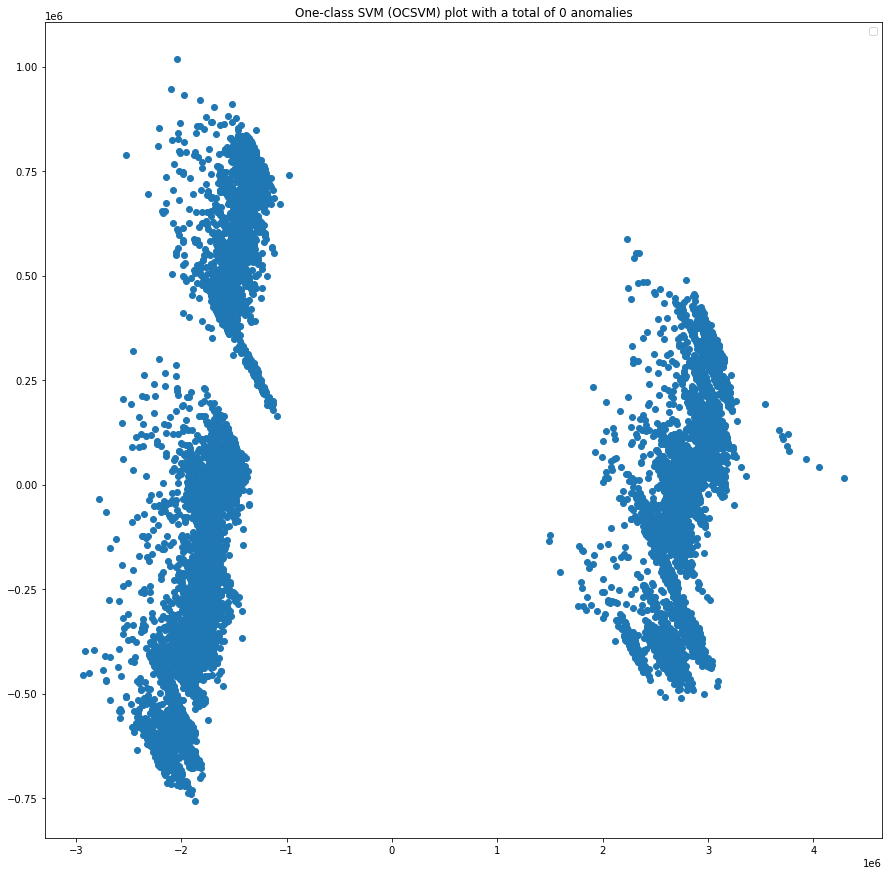

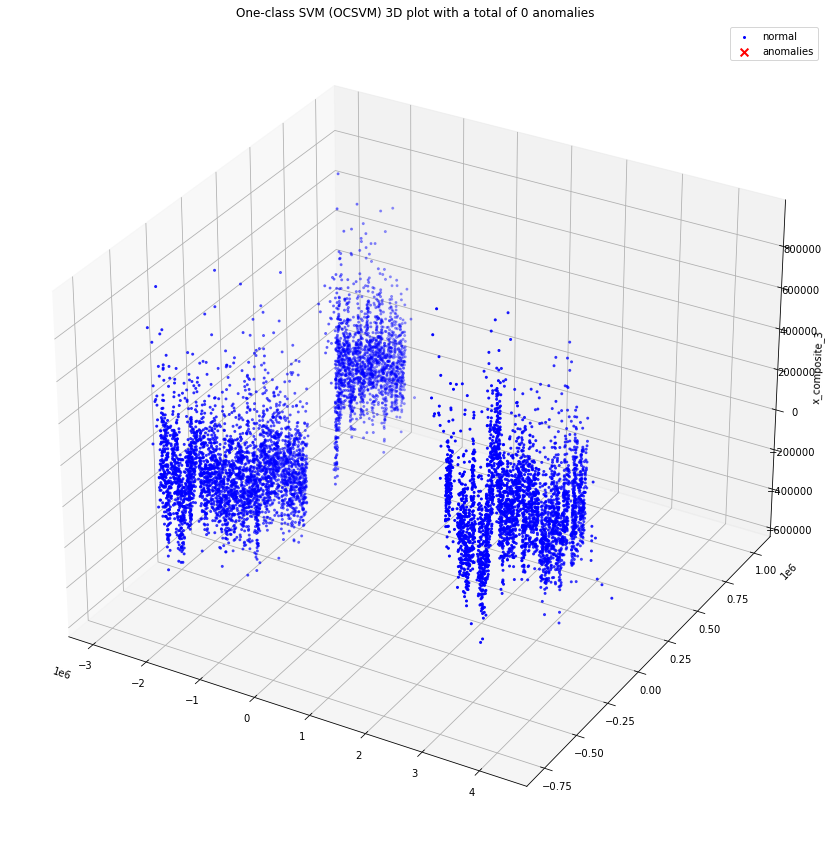

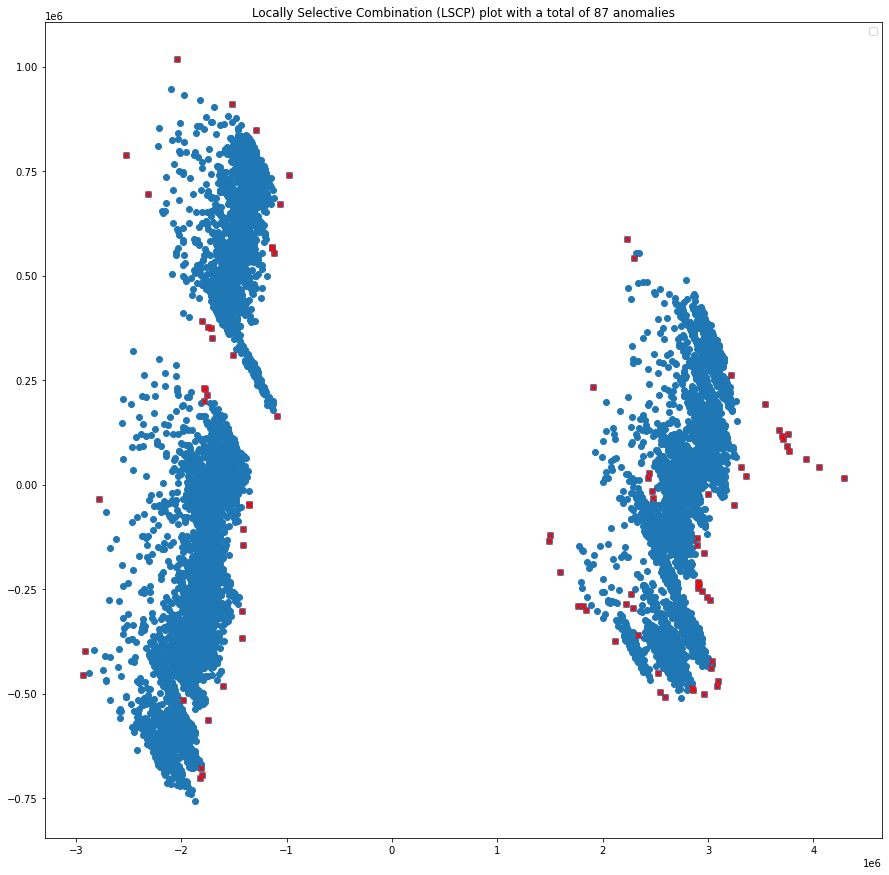

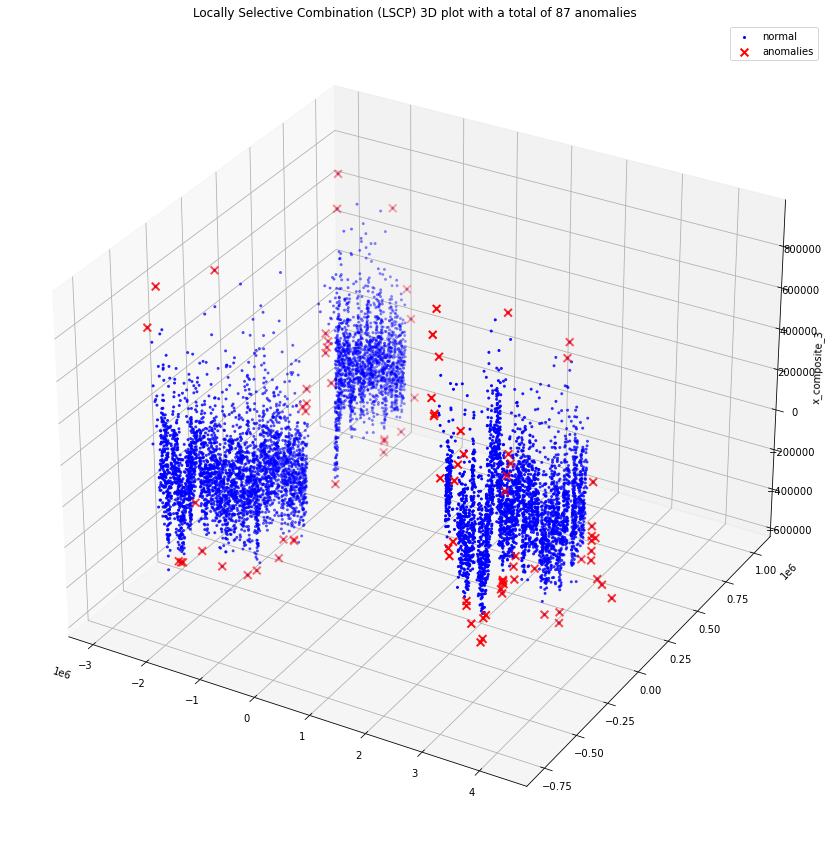

In [38]:
#Preprocess dataset
# dataset_cmp = dataset_raw
import time
# Fit the models with the GUIFI data and
for i, (clf_name, clf) in enumerate(classifiers.items()):
    start_training_time = time.time()
    print(i + 1, 'fitting', clf_name)
    clf.fit(dataset_cmp)
    stop_training_time = time.time() - start_training_time
    print("Completed {} training in:  {}".format(clf_name, stop_training_time))
    scores_pred = clf.decision_function(dataset_cmp) * -1
    start_prediciton_time = time.time()
    y_pred_n = clf.predict(dataset_cmp)
    stop_prediction_time = time.time() - start_prediciton_time
    print("Completed {} prediction in:  {}".format(clf_name, stop_prediction_time))

    transformer = PCA(n_components=2)
    transformer.fit(dataset_raw)
    X_transformed = transformer.transform(dataset_raw)
    print("Initial shape: {}".format(dataset_raw.shape))
    print("PCA data shape: {}".format(X_transformed.shape))

    dataset_cmp  = X_transformed
    anomaly_index_n = np.where(y_pred_n==1)
    values_n = dataset_cmp[anomaly_index_n]
    print(y_pred_n)
    print("Anomalies in dataset of size {} found: {}".format(len(list(y_pred_n)),list(y_pred_n).count(anomaly_label)))
    # print(values)

    #Plot prediction on 2d
    fig = plt.figure(figsize=(15,15))
    plt.scatter(dataset_cmp[:,0], dataset_cmp[:,1])
    plt.scatter(values_n[:,0], values_n[:,1], color='r', marker='x')
    plt.legend()
    plt.title("{} plot with a total of {} anomalies".format(clf_name, list(y_pred_n).count(anomaly_label)))
    plt.show()

    # Data preprocessing options (3d)
    transformer_3d = PCA(n_components=3)
    transformer_3d.fit(dataset_raw)
    X_transformed_3d_n = transformer_3d.transform(dataset_raw)
    print(X_transformed_3d_n.shape)


    # Plot 3D anomaly map
    fig = plt.figure(figsize=(15,15))

    ax = fig.add_subplot(111, projection='3d')
    ax.set_zlabel("x_composite_3")
    # Plot the compressed data points
    ax.scatter(X_transformed_3d_n[:, 0], X_transformed_3d_n[:, 1], zs=X_transformed_3d_n[:, 2], s=4, lw=1, label="normal",c="blue")
    # Plot x's for the ground truth outliers
    ax.scatter(X_transformed_3d_n[anomaly_index_n,0],X_transformed_3d_n[anomaly_index_n,1], X_transformed_3d_n[anomaly_index_n,2],
               lw=2, s=60, marker="x", c="red", label="anomalies")
    ax.legend()
    plt.title("{} 3D plot with a total of {} anomalies".format(clf_name, list(y_pred_n).count(anomaly_label)))
    plt.show()
